<font size=18>Cluster analyses of the image embeddings</font>

---

In this notebook we analyze the (dis-)similarity of the structure of the different gene perturbation embeddings for a selected subset of impactful gene perturbation conditions.

Namely, we will assess the pair-wise co-clustering of the following gene perturbation embedding candidates:
- JUMP image embeddings
- JUMP image embeddings after normalizing them with respect to the batch specific controls (i.e. batch centering)
- JUMP image embeddings after iterative null space projection (INSP)
- JUMP morphological profiles
- JUMP morphological profiles after batch-centering
- JUMP morphological profiles after INSP
- Rohban image embeddings
- Rohban morphological profiles
- CMap signatures
- Regulatory gene embeddings (using the CMap structure)

To assess the co-clustering, we will identify the optimal number of clusters to separate the embeddings of each candidate in and compute a bootstrap p-value for the mutual information of the clustering of any pair of the embeddings.

---

# Environmental setup

In [1]:
import pandas as pd
import numpy as np
from venn import venn
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import AgglomerativeClustering, KMeans
from cmapPy.pandasGEXpress.parse import parse
from scipy.spatial.distance import squareform, pdist
import matplotlib as mpl
import pickle
import os
from sklearn.preprocessing import normalize

import sys
from yellowbrick.cluster import KElbowVisualizer

sys.path.append("../../../")
from src.utils.notebooks.ppi.embedding import plot_tsne_embs
from src.utils.notebooks.images.embedding import *
from src.utils.torch.network import *
from src.utils.notebooks.ppi.embedding import *

mpl.rcParams["figure.dpi"] = 600

In [2]:
def assess_batch_condition_clustering(
    mean_batch_embedding,
    label_col="label",
    batch_col="batch",
    max_cluster=50,
    metric="euclidean",
    linkage="complete",
):
    features = mean_batch_embedding.drop(columns=[label_col, batch_col])
    labels = np.array(mean_batch_embedding.loc[:, label_col])
    batches = np.array(mean_batch_embedding.loc[:, batch_col])
    result = {
        "n_clusters": [],
        "ami": [],
        "mean_prop_clusters_to_group": [],
        "type": [],
    }
    for n_clusters in tqdm(range(2, max_cluster)):
        clustering = AgglomerativeClustering(n_clusters=n_clusters)
        cluster_labels = clustering.fit_predict(features)

        for t in ["condition", "batch"]:
            if t == "condition":
                y = labels
            else:
                y = batches

            result["n_clusters"].append(n_clusters)
            n_clusters_to_group = []
            for label in y:
                n_clusters_to_group.append(
                    len(set(cluster_labels[y == label])) / n_clusters
                )
            result["mean_prop_clusters_to_group"].append(np.mean(n_clusters_to_group))
            result["ami"].append(
                adjusted_mutual_info_score(np.array(y), cluster_labels)
            )
            result["type"].append(t)
    return pd.DataFrame(result)

In [3]:
def plot_clustermap_colored_by_batch_and_condition(
    mean_batch_embeddings, batch_col="batch", label_col="label"
):
    features = mean_batch_embeddings.drop(columns=[batch_col, label_col])
    batch_pal = sns.color_palette("tab20")
    label_pal = sns.color_palette("viridis", 277)

    batch_lut = dict(zip(mean_batch_embeddings.loc[:, batch_col].unique(), batch_pal))
    label_lut = dict(
        zip(sorted(list(mean_batch_embeddings.loc[:, label_col].unique())), label_pal)
    )

    batch_colors = mean_batch_embeddings.loc[:, batch_col].map(batch_lut)
    label_colors = mean_batch_embeddings.loc[:, label_col].map(label_lut)
    g = sns.clustermap(features, row_colors=[batch_colors, label_colors])
    return g

In [4]:
def run_cc_test(cluster_sol1, cluster_sol2, b=1000, score="mi", random_state=1234):
    np.random.seed(random_state)
    cc_score = compute_cc_score(cluster_sol1, cluster_sol2, score=score)
    perm_cc_scores = []
    for i in tqdm(range(b)):
        cluster_sol1_perm = np.random.permutation(cluster_sol1)
        cluster_sol2_perm = np.random.permutation(cluster_sol2)
        perm_cc_score = compute_cc_score(
            cluster_sol1_perm, cluster_sol2_perm, score=score
        )
        perm_cc_scores.append(perm_cc_score)
    perm_cc_scores = np.array(perm_cc_scores)
    return {
        "cc_score": cc_score,
        "perm_cc_scores": perm_cc_scores,
        "pval": np.mean(perm_cc_scores >= (cc_score - 1e-8), axis=0),
    }


In [5]:
def obtain_mean_embeddings(embedding, label_col="label"):
    mean_embedding = embedding.groupby(label_col).mean(numeric_only=True)
    mean_embedding.index = np.array(list(mean_embedding.index))
    mean_embedding["label"] = np.array(list(mean_embedding.index))
    return mean_embedding


def obtain_mean_batch_embeddings(embedding, label_col="label", batch_col="batch"):
    mean_batch_embedding = embedding.groupby([label_col, batch_col]).mean(
        numeric_only=True
    )
    idc = []
    labels = []
    batches = []
    for idx in mean_batch_embedding.index:
        idc.append("_".join([idx[0], idx[1][-1]]))
        labels.append(idx[0])
        batches.append(idx[1])
    mean_batch_embedding["label"] = np.array(labels)
    mean_batch_embedding["batch"] = np.array(batches)
    mean_batch_embedding.index = np.array(idc)
    return mean_batch_embedding

---

# Read in data

We will now read in the required embeddings.

## Regulatory gene embeddings

The first embeddings are the regulatory gene embeddings that we obtained using the inferred gene-gene interactome containing 249 genes and 526 interactions between those as well as the cluster structure of the CMap signatures of all covered nodes as input.

In [6]:
reg_embs = pd.read_csv(
    "../../../data/experiments/rohban/images/embeddings/leave_one_target_out/embeddings/EMPTY/spearman_sol/gae_exp_a1_b0_g1_split_graph_cmap_full_all_nodes/node_embs.csv",
    index_col=0,
)


## JUMP image embeddings and morphological profiles

Next, we load all embeddings obtained for the JUMP image data set including all version of the corresponding image embeddings and morphological profiles that were transformed in the context of trying to remove the batch effects.

In [7]:
emb_dir = "../../../data/experiments/jump/images/embedding/embeddings"

jump_img_embs = pd.read_hdf(os.path.join(emb_dir, "jump_img_embs.h5"), index_col=0)
jump_img_embs_bc = pd.read_hdf(
    os.path.join(emb_dir, "jump_img_embs_bc.h5"), index_col=0
)
jump_img_embs_insp = pd.read_hdf(
    os.path.join(emb_dir, "jump_img_embs_insp.h5"), index_col=0
)

jump_morph_profiles = pd.read_hdf(
    os.path.join(emb_dir, "jump_morph_profiles.h5"), index_col=0
)
jump_morph_profiles_bc = pd.read_hdf(
    os.path.join(emb_dir, "jump_morph_profiles_bc.h5"), index_col=0
)
jump_morph_profiles_insp = pd.read_hdf(
    os.path.join(emb_dir, "jump_morph_profiles_insp.h5"), index_col=0
)

<ipython-input-7-561fd7b22116>:7: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  jump_img_embs_insp = pd.read_hdf(
<ipython-input-7-561fd7b22116>:17: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  jump_morph_profiles_insp = pd.read_hdf(


Note that all the image embeddings correspond to individual nuclei, while the morphological profiles describe individual images. We will obtain to two types of aggregate embeddings:
1. One embedding per condition by averaging across all samples for each OE condition referred to as mean embeddings
2. One embedding per condition and batch by averaging all samples for each OE condition that come from the same batch which we refer to as mean batch embeddings.

In [9]:
mean_jump_img_embs = obtain_mean_embeddings(jump_img_embs, label_col="labels")
mean_jump_img_embs_bc = obtain_mean_embeddings(jump_img_embs_bc, label_col="labels")
mean_jump_img_embs_insp = obtain_mean_embeddings(jump_img_embs_insp, label_col="label")

mean_jump_morph_profiles = obtain_mean_embeddings(
    jump_morph_profiles, label_col="Metadata_Symbol"
)
mean_jump_morph_profiles.iloc[:, :-1] = StandardScaler().fit_transform(
    mean_jump_morph_profiles.iloc[:, :-1]
)
mean_jump_morph_profiles_bc = obtain_mean_embeddings(
    jump_morph_profiles_bc, label_col="label"
)
mean_jump_morph_profiles_insp = obtain_mean_embeddings(
    jump_morph_profiles_insp, label_col="label"
)

In [10]:
mean_batch_jump_img_embs = obtain_mean_batch_embeddings(
    jump_img_embs, label_col="labels", batch_col="batch"
)
mean_batch_jump_img_embs_bc = obtain_mean_batch_embeddings(
    jump_img_embs_bc, label_col="labels", batch_col="batch"
)
mean_batch_jump_img_embs_insp = obtain_mean_batch_embeddings(
    jump_img_embs_insp, label_col="label", batch_col="batch"
)

mean_batch_jump_morph_profiles = obtain_mean_batch_embeddings(
    jump_morph_profiles, label_col="Metadata_Symbol", batch_col="Metadata_Batch"
)
mean_batch_jump_morph_profiles.iloc[:, :-2] = StandardScaler().fit_transform(
    mean_batch_jump_morph_profiles.iloc[:, :-2]
)

mean_batch_jump_morph_profiles_bc = obtain_mean_batch_embeddings(
    jump_morph_profiles_bc, label_col="label", batch_col="batch"
)
mean_batch_jump_morph_profiles_insp = obtain_mean_batch_embeddings(
    jump_morph_profiles_insp, label_col="label", batch_col="batch"
)

---

## Rohban image embeddings and morphological profiles

To compare the cluster structure with our results from the previous study, we also have to load those. Note that we treat that data as some estimate of the desired structure in the latent embeddings as those have shown no batch effects and the data varies primarily by OE setting in contrast to the JUMP data. 

As done in the paper, we use the image embeddings obtained for the first held-out fold. As described before the choice was random but to ensure perfect consistency with the results reported in the paper, we take the same embeddings.

In [11]:
rohban_img_embs = pd.read_hdf(
    "../../../data/experiments/rohban/images/embeddings/four_fold_cv/fold_0/test_latents.h5"
)

label_dict = {
    "AKT1S1": 0,
    "ATF4": 1,
    "BAX": 2,
    "BCL2L11": 3,
    "BRAF": 4,
    "CASP8": 5,
    "CDC42": 6,
    "CDKN1A": 7,
    "CEBPA": 8,
    "CREB1": 9,
    "CXXC4": 10,
    "DIABLO": 11,
    "E2F1": 12,
    "ELK1": 13,
    "EMPTY": 14,
    "ERG": 15,
    "FGFR3": 16,
    "FOXO1": 17,
    "GLI1": 18,
    "HRAS": 19,
    "IRAK4": 20,
    "JUN": 21,
    "MAP2K3": 22,
    "MAP3K2": 23,
    "MAP3K5": 24,
    "MAP3K9": 25,
    "MAPK7": 26,
    "MOS": 27,
    "MYD88": 28,
    "PIK3R2": 29,
    "PRKACA": 30,
    "PRKCE": 31,
    "RAF1": 32,
    "RELB": 33,
    "RHOA": 34,
    "SMAD4": 35,
    "SMO": 36,
    "SRC": 37,
    "SREBF1": 38,
    "TRAF2": 39,
    "TSC2": 40,
    "WWTR1": 41,
}
label_dict = dict(zip(list(label_dict.values()), list(label_dict.keys())))
rohban_img_embs.loc[:, "labels"] = np.array(rohban_img_embs.labels.map(label_dict))
mean_rohban_img_embs = rohban_img_embs.groupby("labels").mean()

In [12]:
morph_profiles = pd.read_csv(
    "../../../data/resources/images/rohban/profiles/nuclei_profiles_hoechst_cleaned.csv",
    index_col=0,
)
mean_rohban_morph_profiles = (
    morph_profiles.groupby("labels").mean().drop(columns=["ImageNumber"])
)
mean_rohban_morph_profiles = mean_rohban_morph_profiles.drop(
    mean_rohban_morph_profiles.filter(regex="_X").columns, axis=1
)
mean_rohban_morph_profiles = mean_rohban_morph_profiles.drop(
    mean_rohban_morph_profiles.filter(regex="_Y").columns, axis=1
)
mean_rohban_morph_profiles = pd.DataFrame(
    StandardScaler().fit_transform(mean_rohban_morph_profiles),
    index=mean_rohban_morph_profiles.index,
    columns=mean_rohban_morph_profiles.columns,
)

---

## CMap signatures

Finally, we read in the CMap gene signatures.

In [13]:
cmap_sigs = pd.read_csv(
    "../../../data/experiments/rohban/gex/cmap/mean_l5_signatures_tmp.csv", index_col=0
)

---

# Clustering of the different mean-batch profiles and embeddings.

As a first preliminary analyses, we will assess if the different JUMP embedding candidates primarily cluster by OE condition or by batch. To this end, we will divide the respective embeddings into 50 distinct to 2 different clusters and assess how many samples from the same OE condition respectively the same batch end up in the same cluster.

## JUMP image embeddings

100%|██████████| 48/48 [00:01<00:00, 27.05it/s]


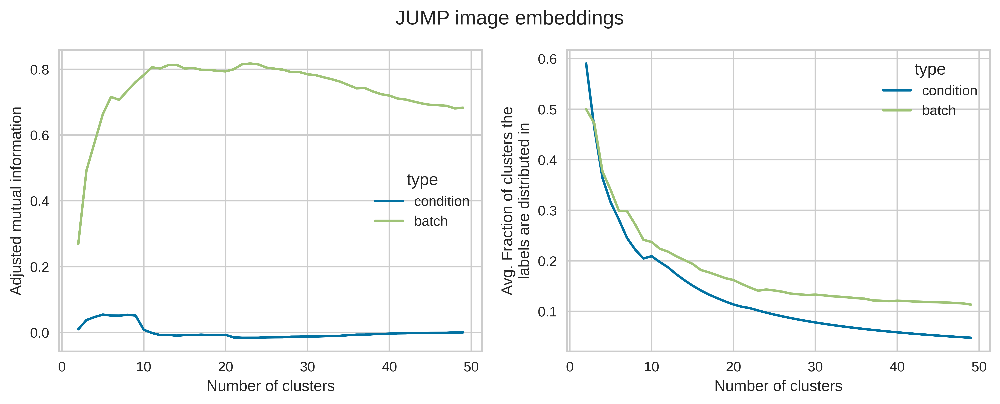

In [14]:
assessment_results = assess_batch_condition_clustering(
    mean_batch_jump_img_embs, linkage="complete", metric="euclidean"
)
fig, ax = plt.subplots(figsize=[12, 4], ncols=2)
ax = ax.flatten()
ax[0] = sns.lineplot(
    data=assessment_results, x="n_clusters", y="ami", hue="type", ax=ax[0]
)
ax[0].set_xlabel("Number of clusters")
ax[0].set_ylabel("Adjusted mutual information")
ax[1] = sns.lineplot(
    data=assessment_results,
    x="n_clusters",
    y="mean_prop_clusters_to_group",
    hue="type",
    ax=ax[1],
)
ax[1].set_ylabel("Avg. Fraction of clusters the\nlabels are distributed in")
ax[1].set_xlabel("Number of clusters")

fig.suptitle("JUMP image embeddings")
plt.show()

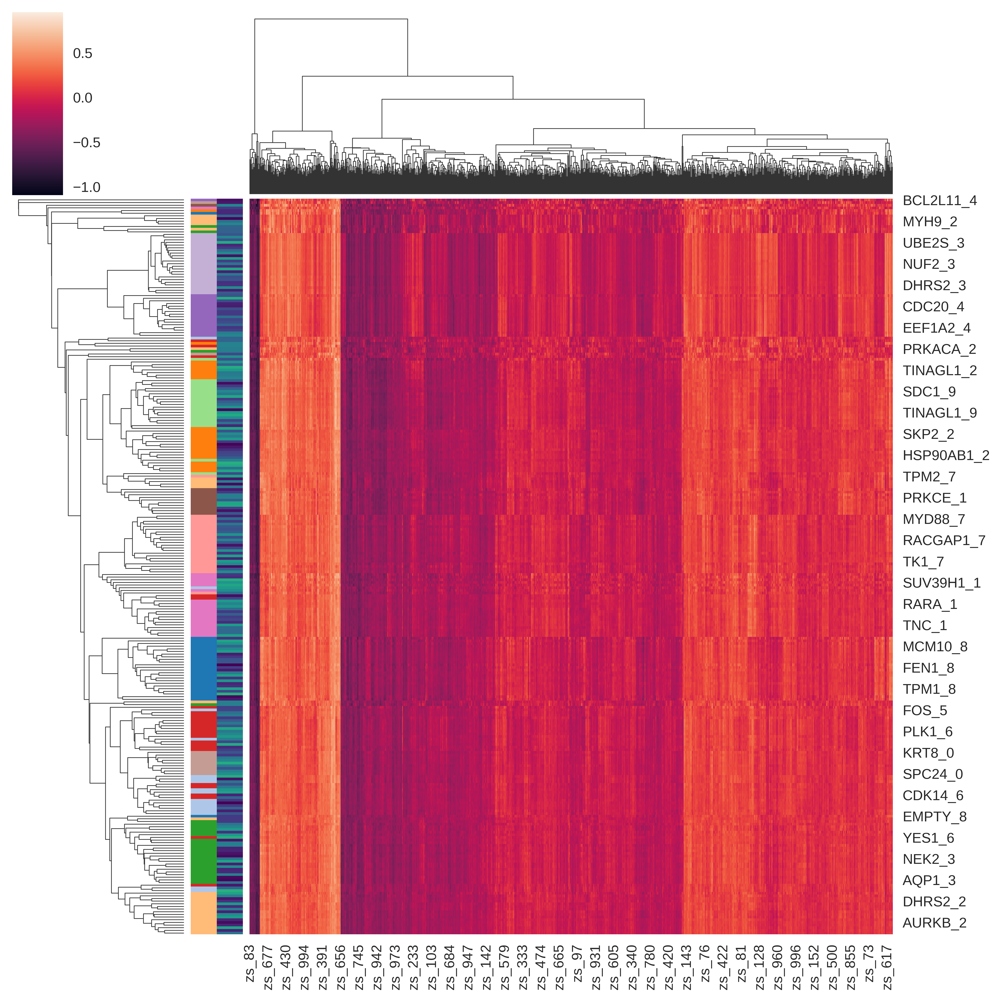

In [15]:
g = plot_clustermap_colored_by_batch_and_condition(mean_batch_jump_img_embs)

---

## Batch-corrected JUMP image embeddings

100%|██████████| 48/48 [00:01<00:00, 26.25it/s]


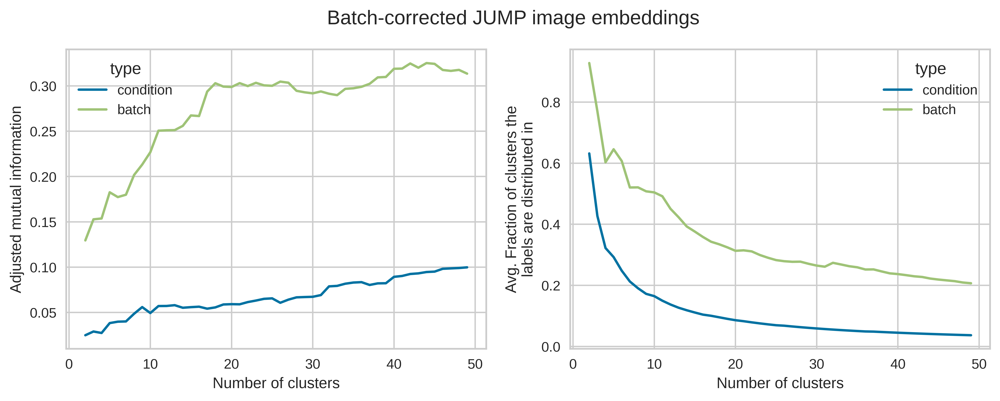

In [16]:
assessment_results = assess_batch_condition_clustering(
    mean_batch_jump_img_embs_bc, linkage="complete", metric="euclidean"
)
fig, ax = plt.subplots(figsize=[12, 4], ncols=2)
ax = ax.flatten()
ax[0] = sns.lineplot(
    data=assessment_results, x="n_clusters", y="ami", hue="type", ax=ax[0]
)
ax[0].set_xlabel("Number of clusters")
ax[0].set_ylabel("Adjusted mutual information")
ax[1] = sns.lineplot(
    data=assessment_results,
    x="n_clusters",
    y="mean_prop_clusters_to_group",
    hue="type",
    ax=ax[1],
)
ax[1].set_ylabel("Avg. Fraction of clusters the\nlabels are distributed in")
ax[1].set_xlabel("Number of clusters")

fig.suptitle("Batch-corrected JUMP image embeddings")
plt.show()

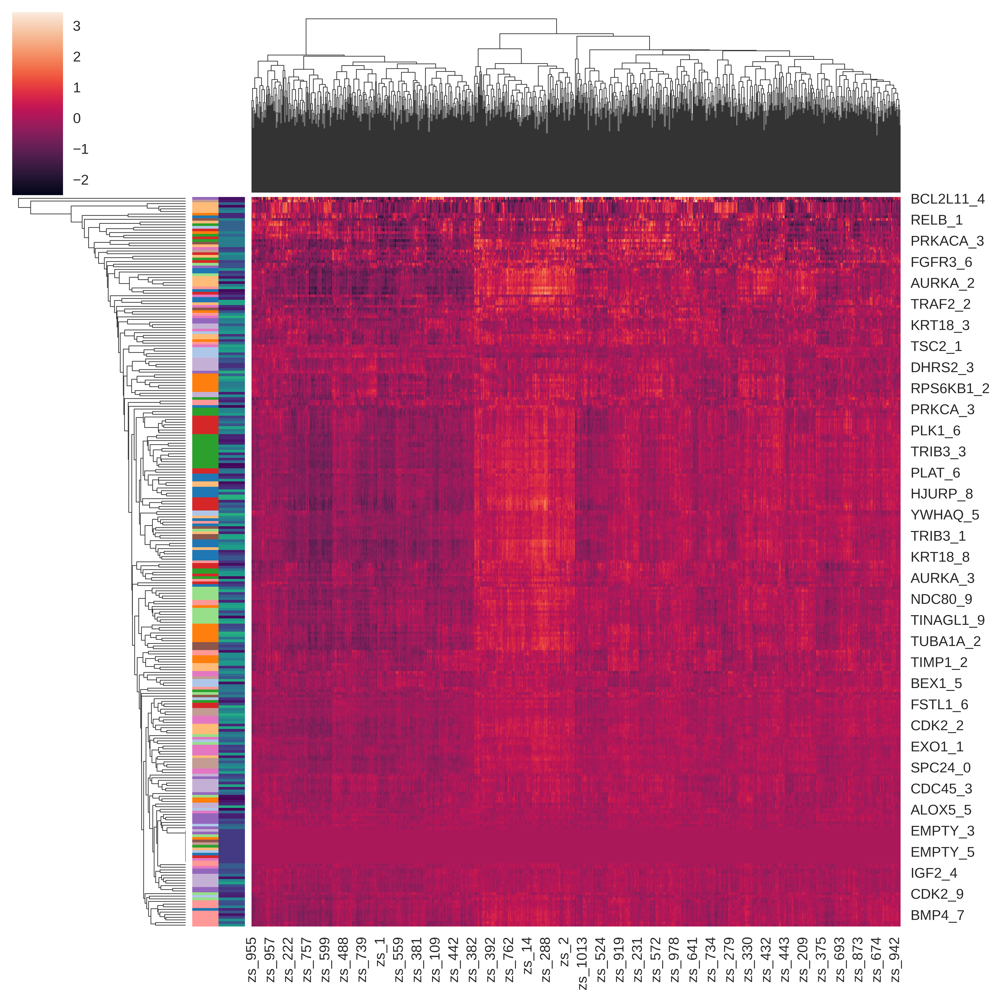

In [17]:
g = plot_clustermap_colored_by_batch_and_condition(mean_batch_jump_img_embs_bc)

---

## INSP-adjusted JUMP image embeddings

100%|██████████| 48/48 [00:01<00:00, 28.84it/s]


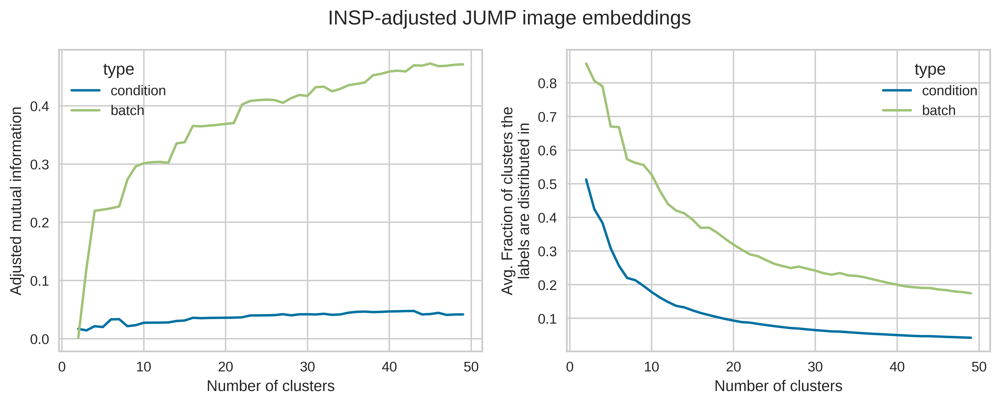

In [18]:
assessment_results = assess_batch_condition_clustering(
    mean_batch_jump_img_embs_insp, linkage="complete", metric="euclidean"
)
fig, ax = plt.subplots(figsize=[12, 4], ncols=2)
ax = ax.flatten()
ax[0] = sns.lineplot(
    data=assessment_results, x="n_clusters", y="ami", hue="type", ax=ax[0]
)
ax[0].set_xlabel("Number of clusters")
ax[0].set_ylabel("Adjusted mutual information")
ax[1] = sns.lineplot(
    data=assessment_results,
    x="n_clusters",
    y="mean_prop_clusters_to_group",
    hue="type",
    ax=ax[1],
)
ax[1].set_ylabel("Avg. Fraction of clusters the\nlabels are distributed in")
ax[1].set_xlabel("Number of clusters")

fig.suptitle("INSP-adjusted JUMP image embeddings")
plt.show()

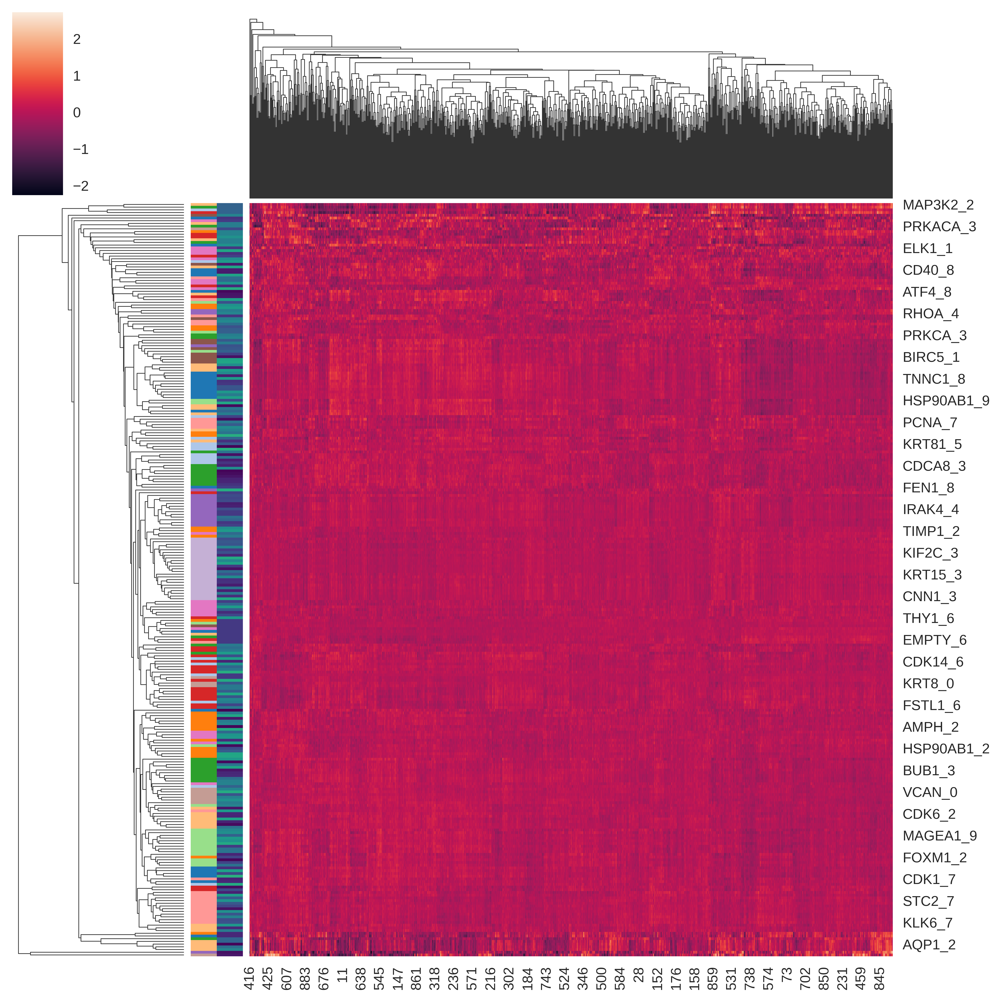

In [19]:
g = plot_clustermap_colored_by_batch_and_condition(mean_batch_jump_img_embs_insp)

---

## JUMP morphological profiles

100%|██████████| 48/48 [00:01<00:00, 44.26it/s]


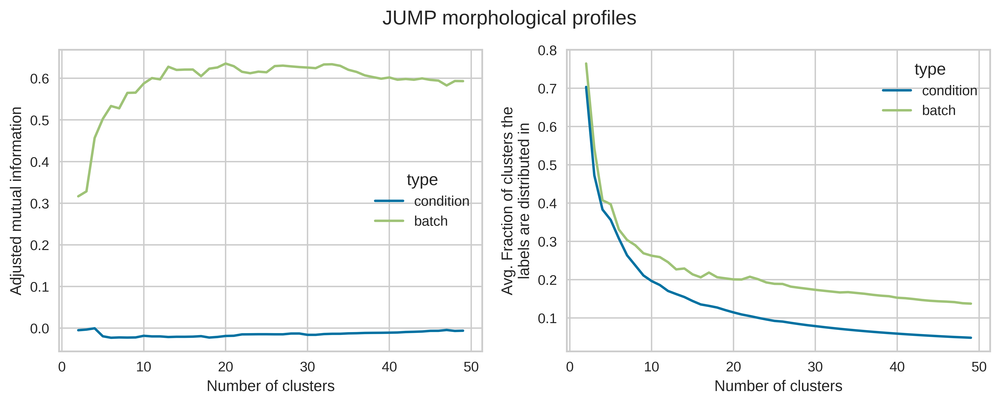

In [20]:
assessment_results = assess_batch_condition_clustering(
    mean_batch_jump_morph_profiles, linkage="complete", metric="euclidean"
)
fig, ax = plt.subplots(figsize=[12, 4], ncols=2)
ax = ax.flatten()
ax[0] = sns.lineplot(
    data=assessment_results, x="n_clusters", y="ami", hue="type", ax=ax[0]
)
ax[0].set_xlabel("Number of clusters")
ax[0].set_ylabel("Adjusted mutual information")
ax[1] = sns.lineplot(
    data=assessment_results,
    x="n_clusters",
    y="mean_prop_clusters_to_group",
    hue="type",
    ax=ax[1],
)
ax[1].set_ylabel("Avg. Fraction of clusters the\nlabels are distributed in")
ax[1].set_xlabel("Number of clusters")

fig.suptitle("JUMP morphological profiles")
plt.show()

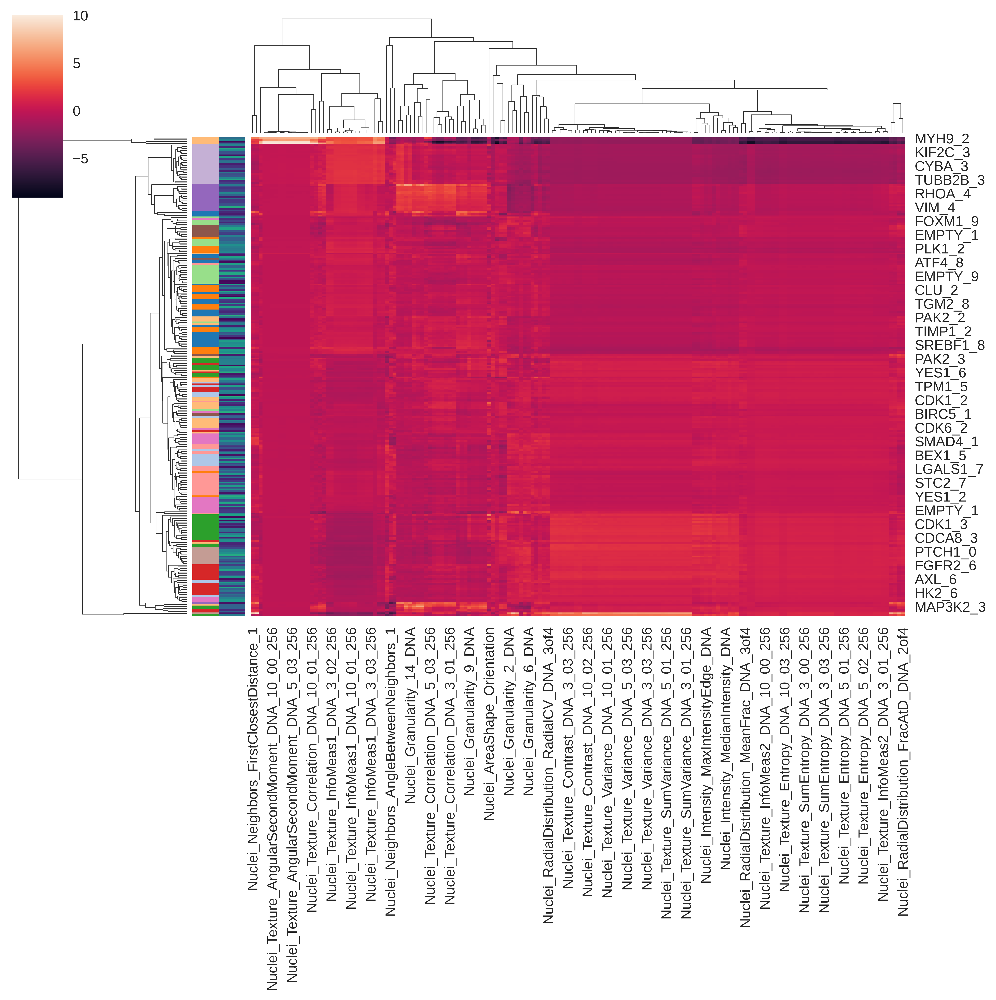

In [21]:
g = plot_clustermap_colored_by_batch_and_condition(mean_batch_jump_morph_profiles)

---

## Batch-centered JUMP morphological profiles

100%|██████████| 48/48 [00:01<00:00, 47.70it/s]


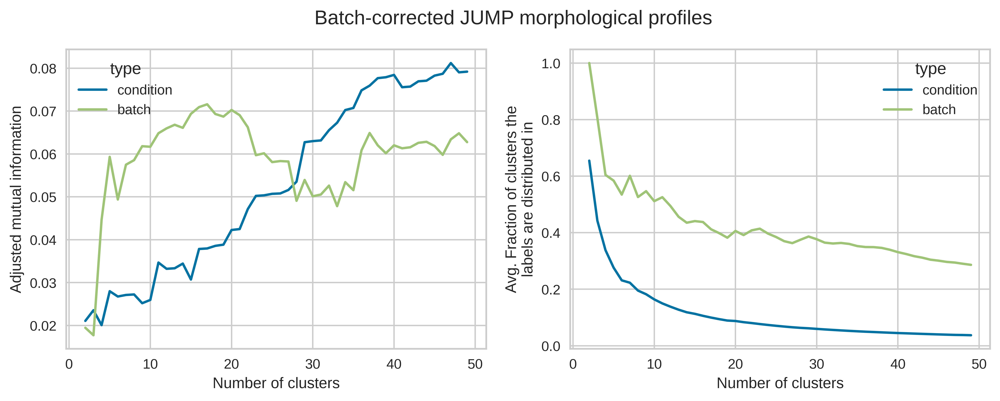

In [22]:
assessment_results = assess_batch_condition_clustering(
    mean_batch_jump_morph_profiles_bc, linkage="complete", metric="euclidean"
)
fig, ax = plt.subplots(figsize=[12, 4], ncols=2)
ax = ax.flatten()
ax[0] = sns.lineplot(
    data=assessment_results, x="n_clusters", y="ami", hue="type", ax=ax[0]
)
ax[0].set_xlabel("Number of clusters")
ax[0].set_ylabel("Adjusted mutual information")
ax[1] = sns.lineplot(
    data=assessment_results,
    x="n_clusters",
    y="mean_prop_clusters_to_group",
    hue="type",
    ax=ax[1],
)
ax[1].set_ylabel("Avg. Fraction of clusters the\nlabels are distributed in")
ax[1].set_xlabel("Number of clusters")

fig.suptitle("Batch-corrected JUMP morphological profiles")
plt.show()

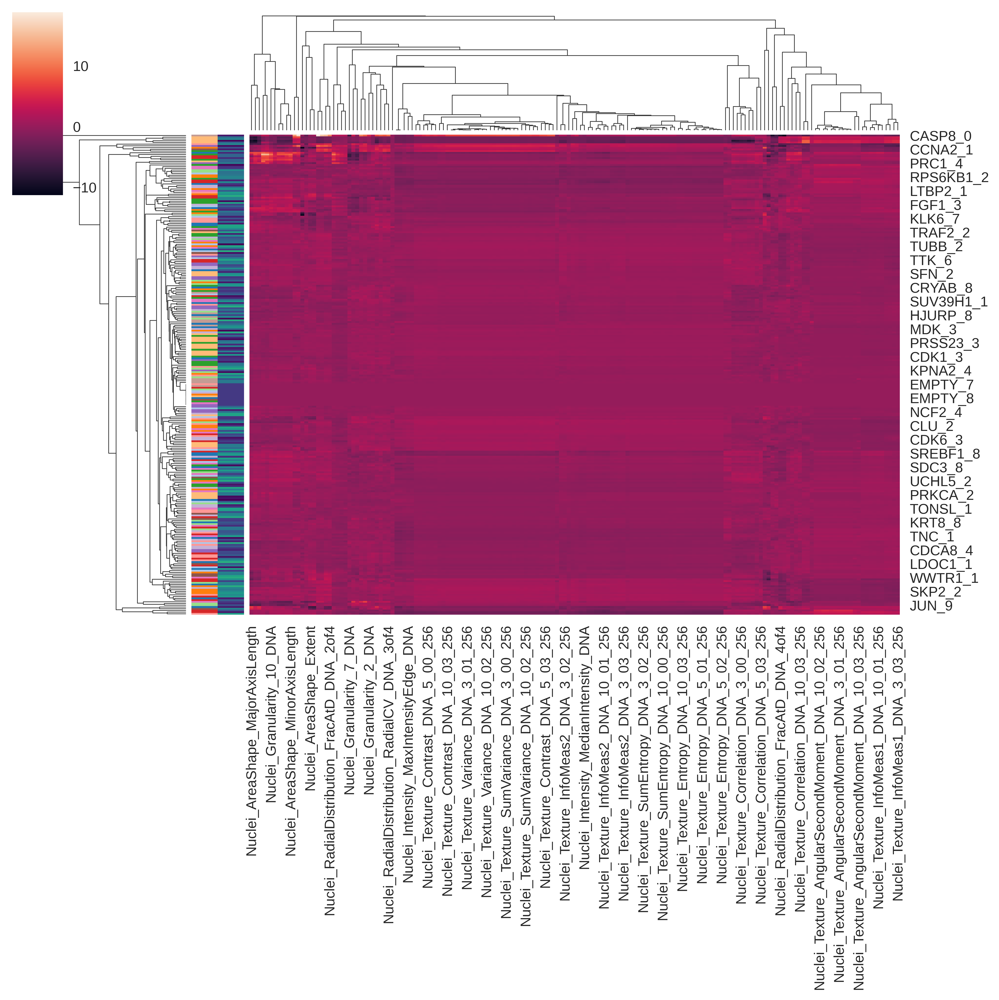

In [23]:
g = plot_clustermap_colored_by_batch_and_condition(mean_batch_jump_morph_profiles_bc)

---

## INSP-adjusted JUMP morphological profiles

100%|██████████| 48/48 [00:00<00:00, 52.23it/s]


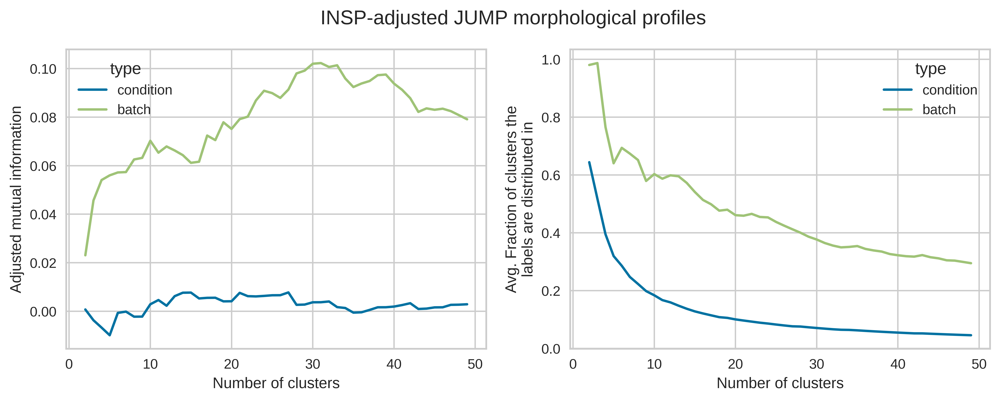

In [24]:
assessment_results = assess_batch_condition_clustering(
    mean_batch_jump_morph_profiles_insp, linkage="complete", metric="euclidean"
)
fig, ax = plt.subplots(figsize=[12, 4], ncols=2)
ax = ax.flatten()
ax[0] = sns.lineplot(
    data=assessment_results, x="n_clusters", y="ami", hue="type", ax=ax[0]
)
ax[0].set_xlabel("Number of clusters")
ax[0].set_ylabel("Adjusted mutual information")
ax[1] = sns.lineplot(
    data=assessment_results,
    x="n_clusters",
    y="mean_prop_clusters_to_group",
    hue="type",
    ax=ax[1],
)
ax[1].set_ylabel("Avg. Fraction of clusters the\nlabels are distributed in")
ax[1].set_xlabel("Number of clusters")

fig.suptitle("INSP-adjusted JUMP morphological profiles")
plt.show()

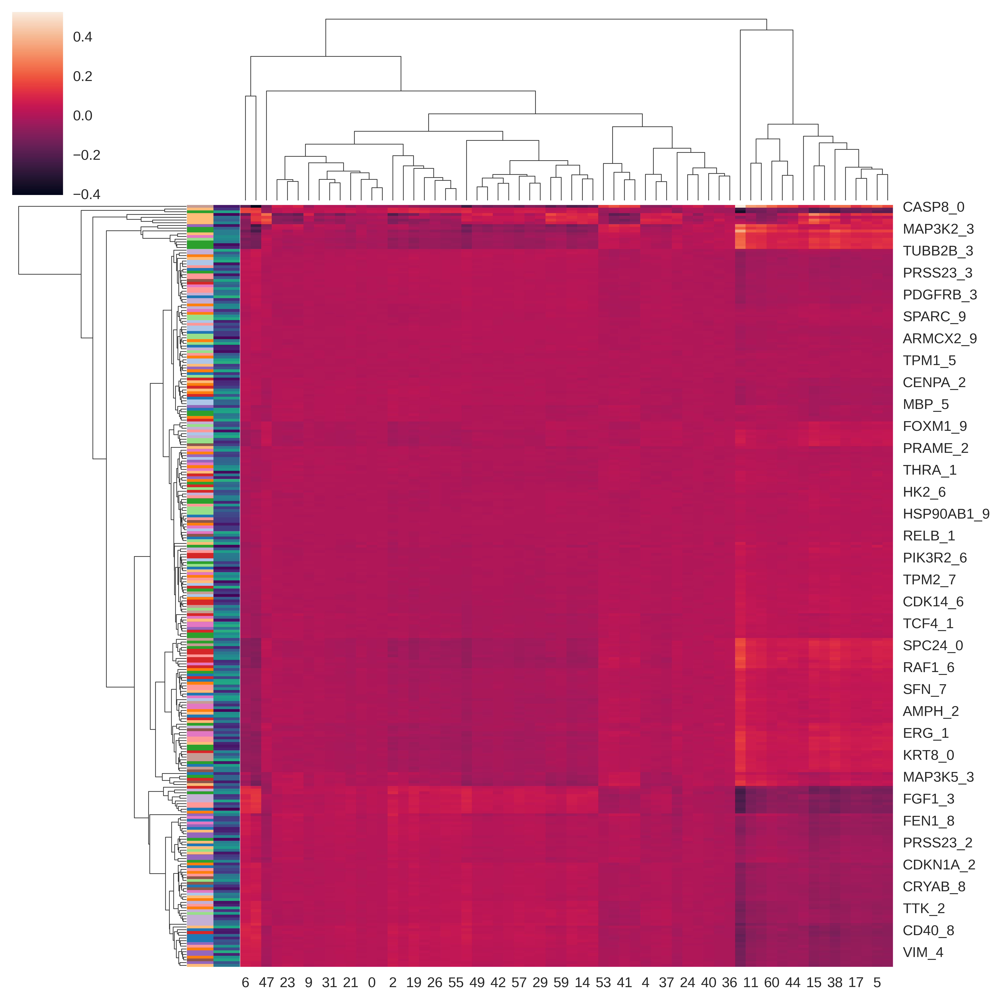

In [25]:
g = plot_clustermap_colored_by_batch_and_condition(mean_batch_jump_morph_profiles_insp)

---

# Clustering of the different mean profiles, signatures and embeddings

As a described above, we will now individually obtain the optimal cluster solution for all of the different candidates for our gene perturbation embeddings. To this end, we will look a the Calinski-Harabasz score when clustering the embeddings using complete linkage. Note that we will generally use the euclidean distance to cluster all but the CMap signatures and the regulatory gene embeddings. For the latter we will use the cosine distances which are more meaningful for these cases.

In [26]:
shared_genes = list(
    set(reg_embs.index)
    .intersection(mean_jump_img_embs.index)
    .intersection(mean_rohban_img_embs.index)
    .intersection(cmap_sigs.index)
)
print(sorted(shared_genes))

['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDKN1A', 'CREB1', 'DIABLO', 'ELK1', 'ERG', 'FGFR3', 'HRAS', 'IRAK4', 'JUN', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1']


---

## JUMP image embeddings



In [27]:
shared_jump_img_embs = mean_jump_img_embs.loc[shared_genes].iloc[:, :-1]

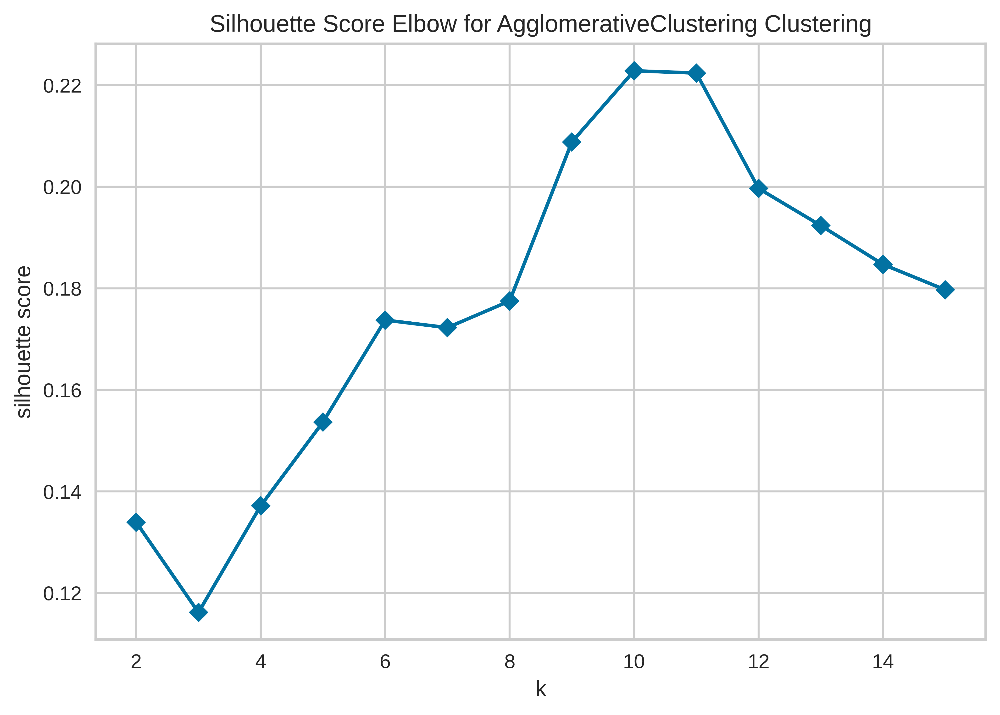

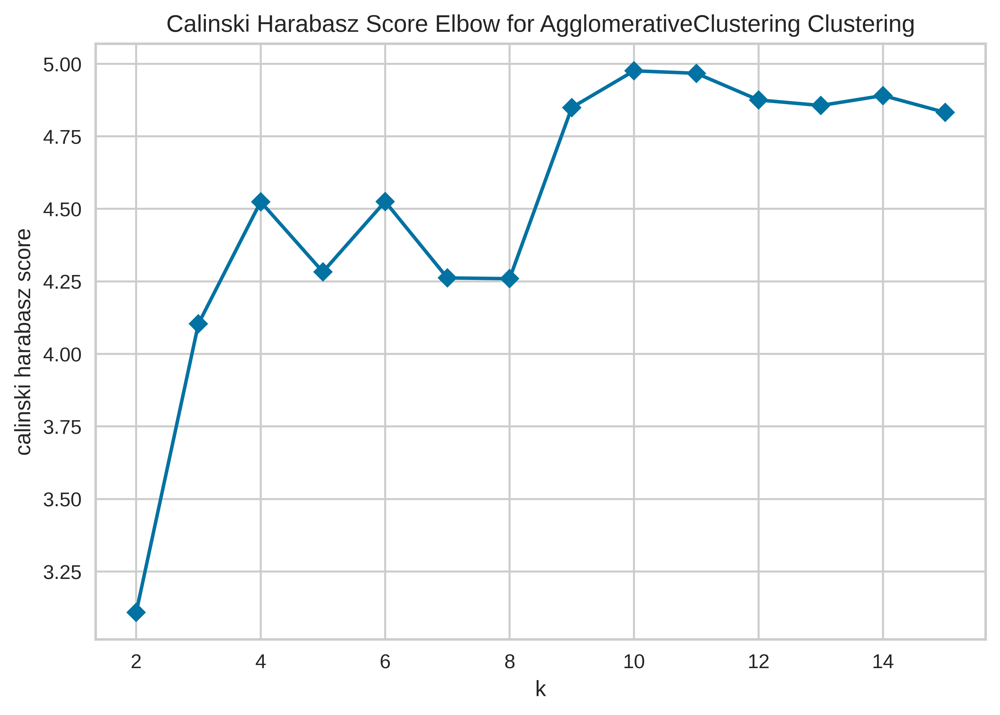

In [28]:
model = AgglomerativeClustering(affinity="euclidean", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_img_embs)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_img_embs)
ax = visualizer.show()


The optimal number of cluster seems to be 10 for our image-based embeddings. As we have seen before these are likely the different batches.

In [29]:
model = AgglomerativeClustering(n_clusters=10, affinity="euclidean", linkage="complete")
shared_jump_img_embs_cluster_labels = model.fit_predict(shared_jump_img_embs)
shared_jump_img_embs_clusters = pd.DataFrame(
    shared_jump_img_embs_cluster_labels,
    index=shared_jump_img_embs.index,
    columns=["cluster"],
)
shared_jump_img_embs_clusters.head()

,cluster
PRKACA,3
ATF4,5
DIABLO,5
BRAF,5
MYD88,4


---

## Batch-centered JUMP image embeddings



In [30]:
shared_jump_img_embs_bc = mean_jump_img_embs_bc.loc[shared_genes].iloc[:, :-1]

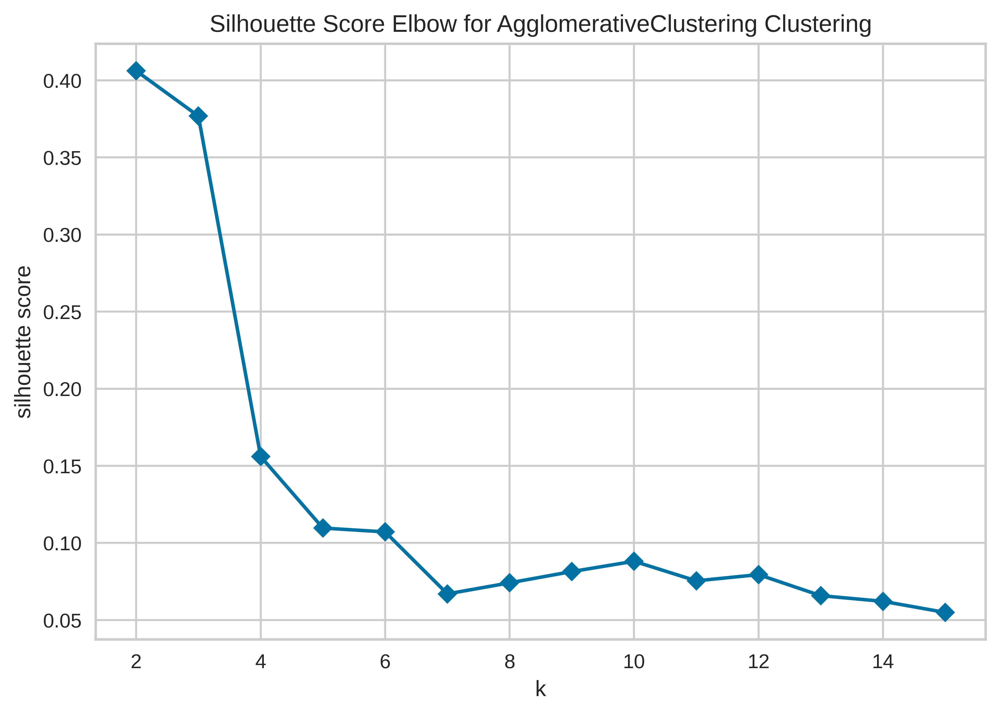

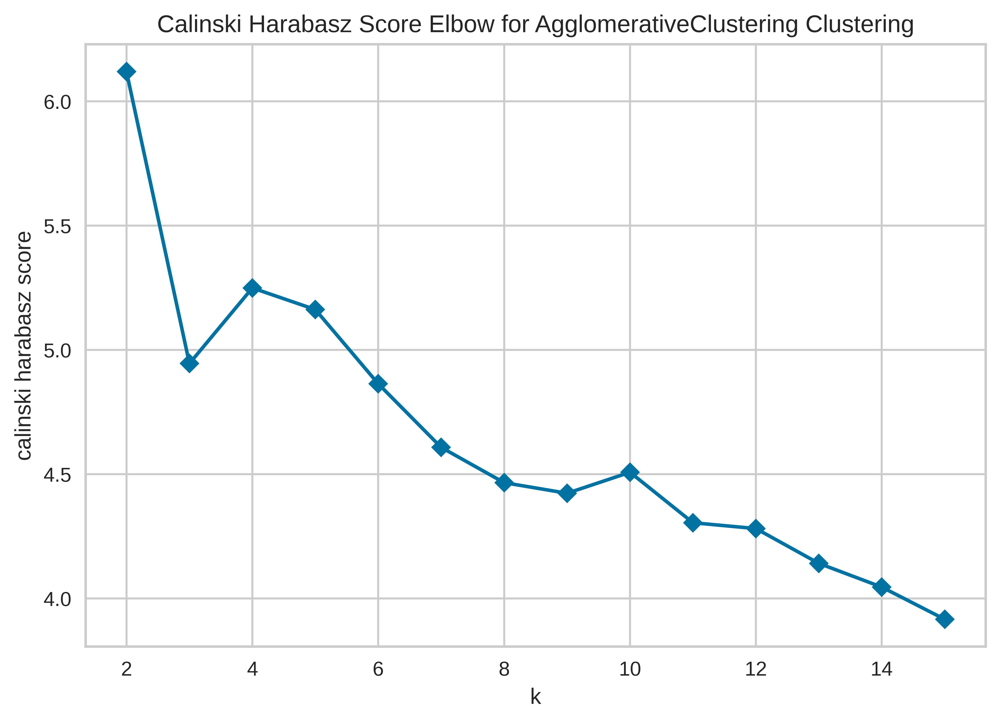

In [31]:
model = AgglomerativeClustering(affinity="euclidean", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_img_embs_bc)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_img_embs_bc)
ax = visualizer.show()


The optimal number of cluster seems to be 6 for our batch-centered JUMP image-based embeddings.

In [32]:
model = AgglomerativeClustering(n_clusters=6, affinity="euclidean", linkage="complete")
shared_jump_img_embs_bc_cluster_labels = model.fit_predict(shared_jump_img_embs_bc)
shared_jump_img_embs_bc_clusters = pd.DataFrame(
    shared_jump_img_embs_bc_cluster_labels,
    index=shared_jump_img_embs_bc.index,
    columns=["cluster"],
)
shared_jump_img_embs_bc_clusters.head()

,cluster
PRKACA,0
ATF4,4
DIABLO,4
BRAF,4
MYD88,0


---

## INSP-corrected JUMP image embeddings



In [33]:
shared_jump_img_embs_insp = mean_jump_img_embs_insp.loc[shared_genes].iloc[:, :-1]

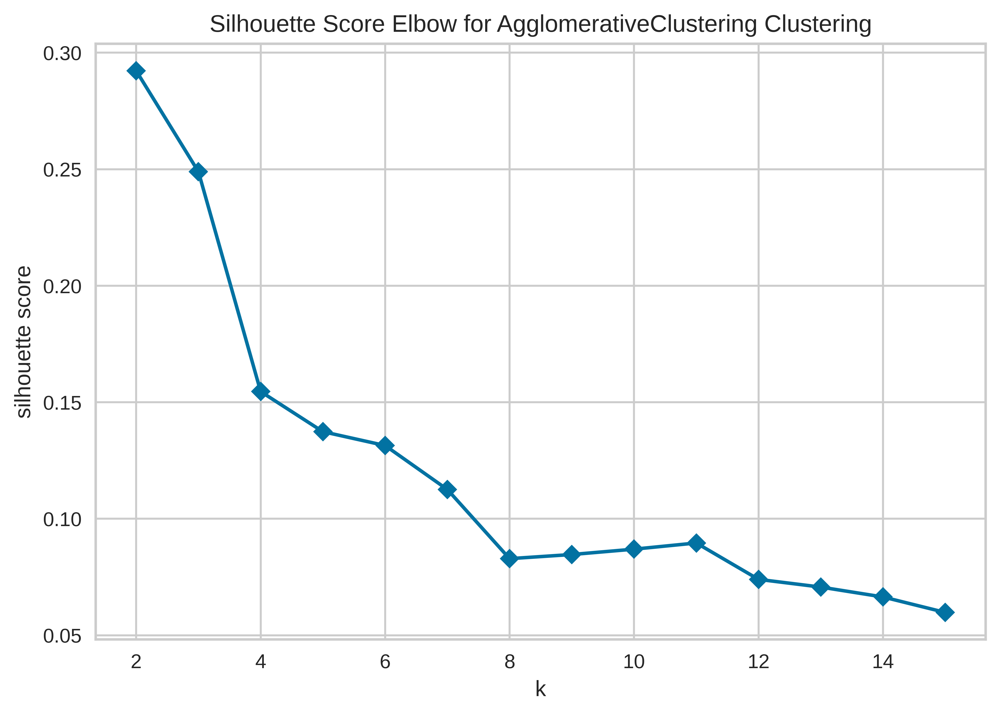

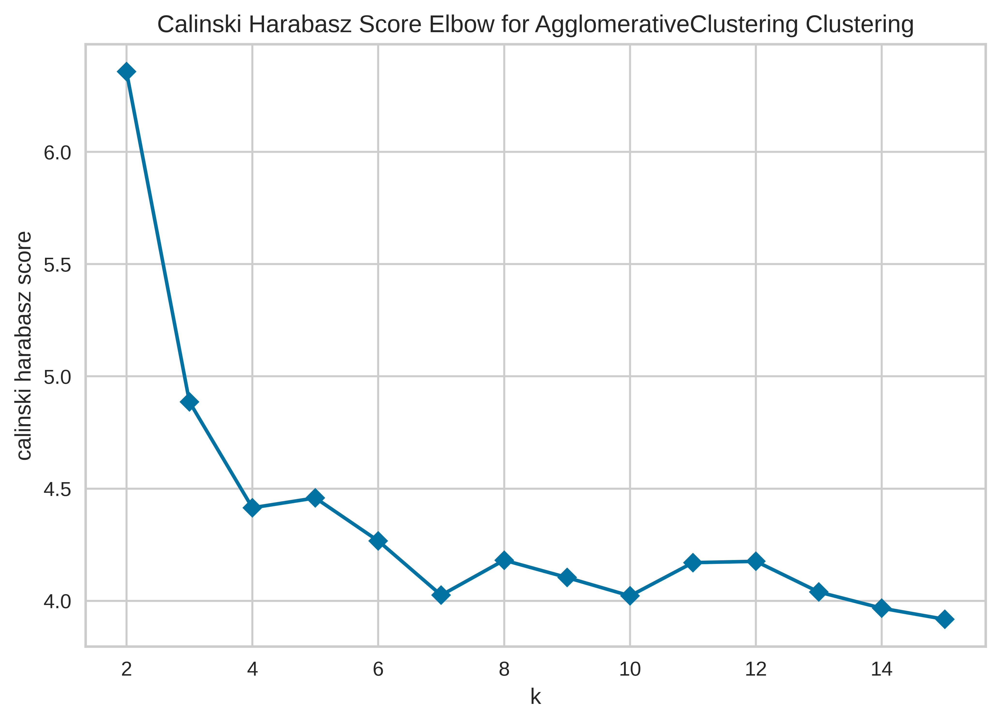

In [34]:
model = AgglomerativeClustering(affinity="euclidean", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_img_embs_insp)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_img_embs_insp)
ax = visualizer.show()


The optimal number of cluster seems to be 10 for our INSP-corrected JUMP image-based embeddings.

In [35]:
model = AgglomerativeClustering(n_clusters=10, affinity="euclidean", linkage="complete")
shared_jump_img_embs_insp_cluster_labels = model.fit_predict(shared_jump_img_embs_insp)
shared_jump_img_embs_insp_clusters = pd.DataFrame(
    shared_jump_img_embs_insp_cluster_labels,
    index=shared_jump_img_embs_insp.index,
    columns=["cluster"],
)
shared_jump_img_embs_insp_clusters.head()

,cluster
PRKACA,0
ATF4,1
DIABLO,3
BRAF,1
MYD88,0


---

## JUMP morphological profiles



In [36]:
shared_jump_morph_embs = mean_jump_morph_profiles.loc[shared_genes].iloc[:, :-1]

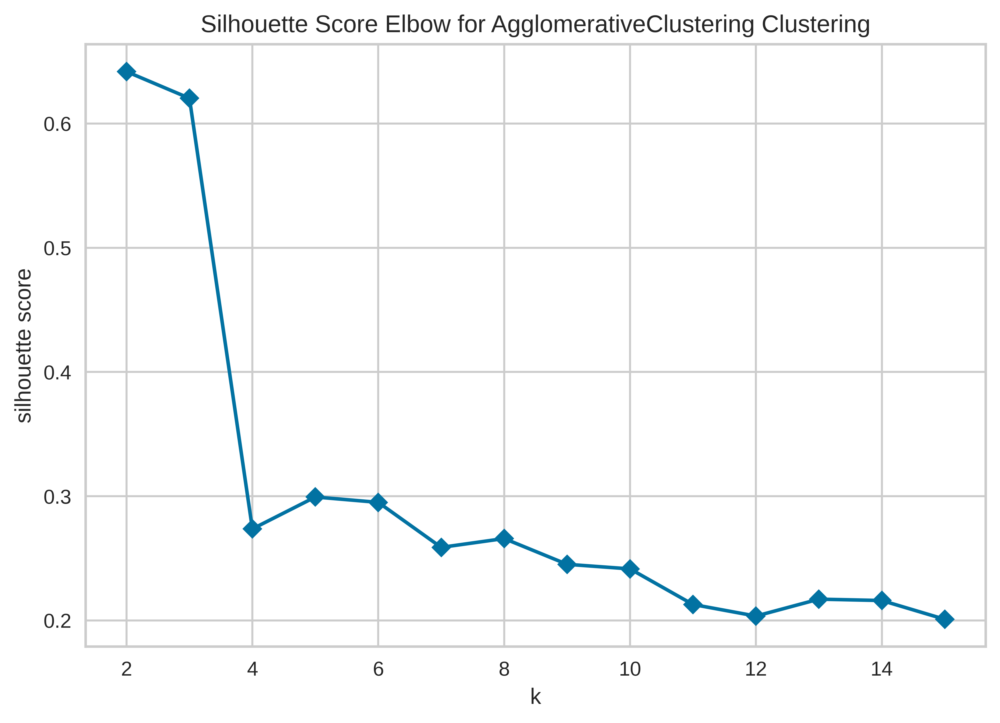

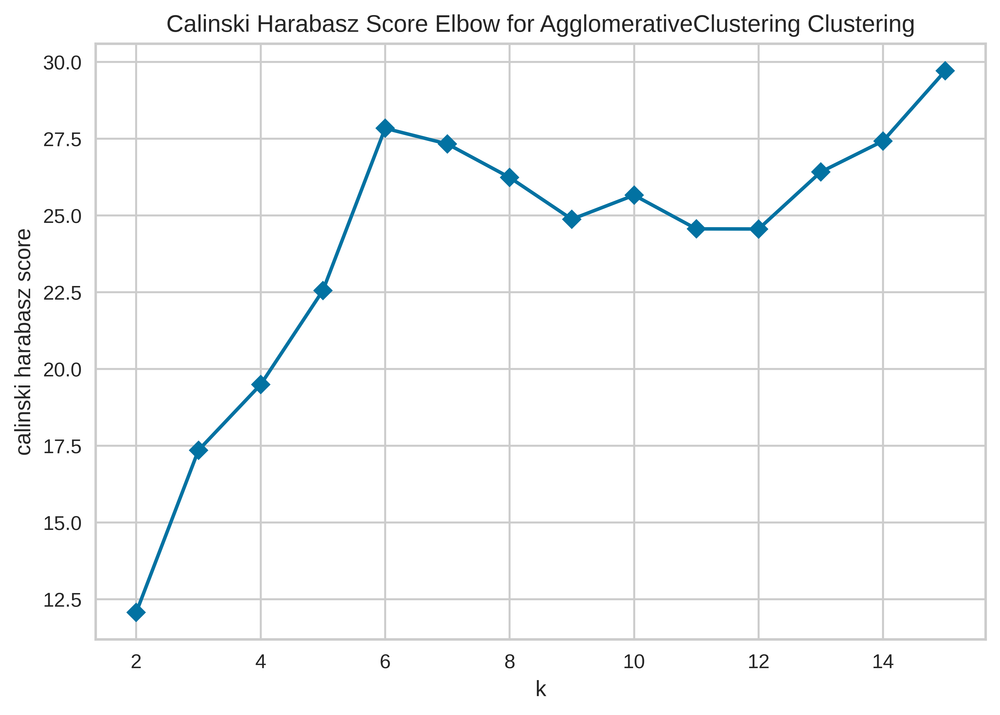

In [37]:
model = AgglomerativeClustering(affinity="euclidean", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_morph_embs)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_morph_embs)
ax = visualizer.show()


The optimal number of cluster seems to be 6 for our batch-centered JUMP morphological profiles.

In [38]:
model = AgglomerativeClustering(n_clusters=6, affinity="euclidean", linkage="complete")
shared_jump_morph_embs_cluster_labels = model.fit_predict(shared_jump_morph_embs)
shared_jump_morph_embs_clusters = pd.DataFrame(
    shared_jump_morph_embs_cluster_labels,
    index=shared_jump_morph_embs.index,
    columns=["cluster"],
)
shared_jump_morph_embs_clusters.head()

,cluster
PRKACA,2
ATF4,4
DIABLO,4
BRAF,0
MYD88,0


---
## Batch-centered JUMP morphological profiles



In [39]:
shared_jump_morph_embs_bc = mean_jump_morph_profiles_bc.loc[shared_genes].iloc[:, :-1]

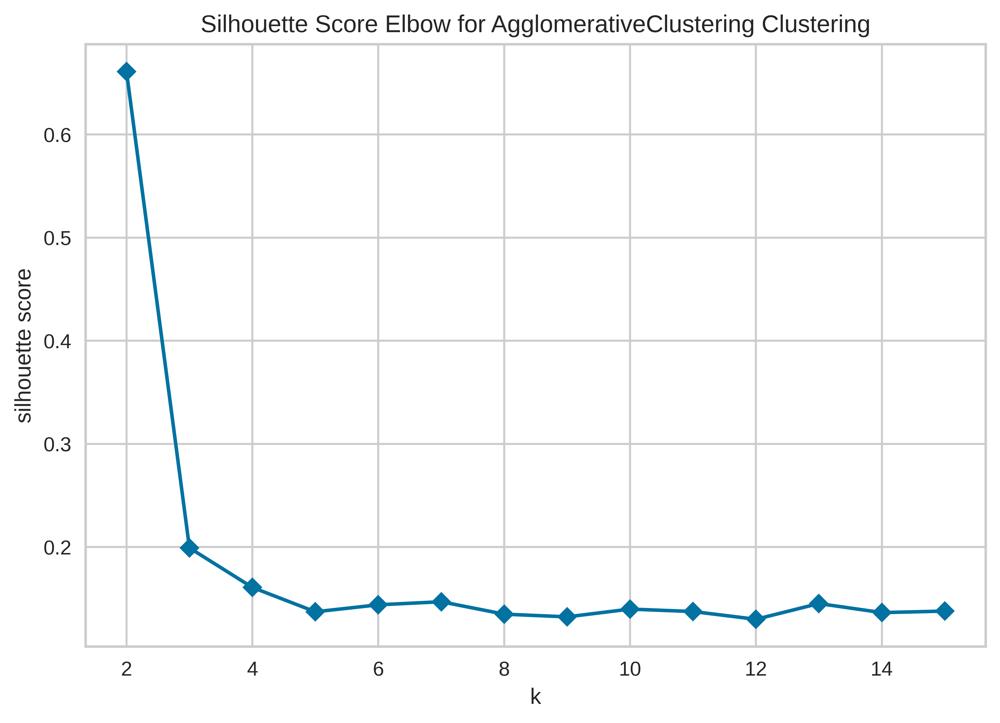

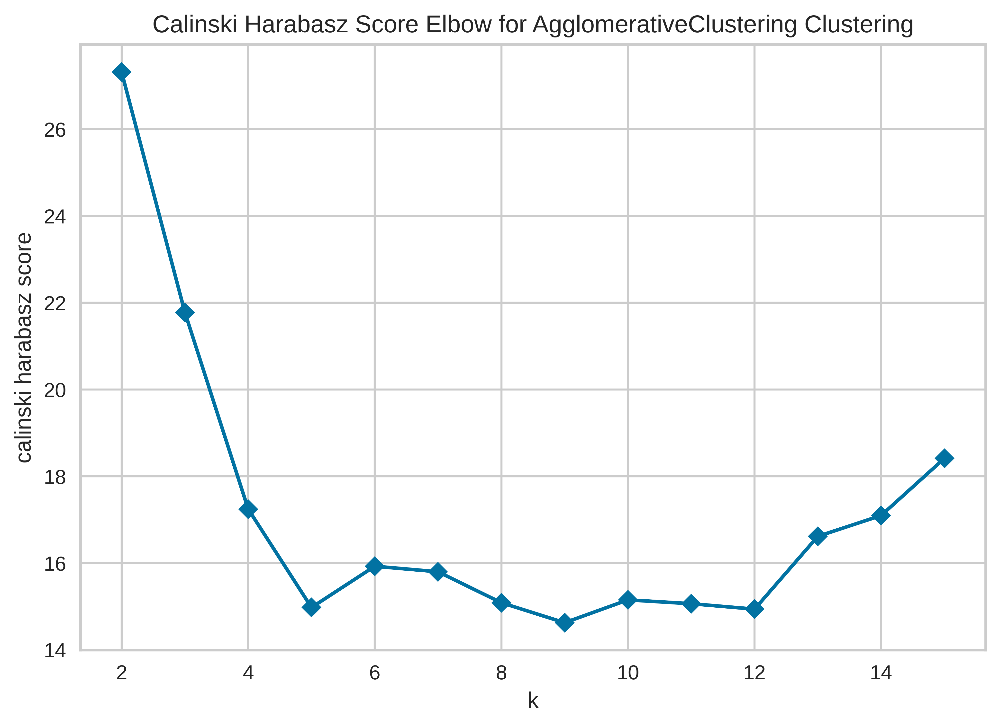

In [40]:
model = AgglomerativeClustering(affinity="euclidean", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_morph_embs_bc)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_morph_embs_bc)
ax = visualizer.show()


The optimal number of cluster seems to be 6 for our batch-centered JUMP morphological profiles.

In [41]:
model = AgglomerativeClustering(n_clusters=6, affinity="euclidean", linkage="complete")
shared_jump_morph_embs_bc_cluster_labels = model.fit_predict(shared_jump_morph_embs_bc)
shared_jump_morph_embs_bc_clusters = pd.DataFrame(
    shared_jump_morph_embs_bc_cluster_labels,
    index=shared_jump_morph_embs_bc.index,
    columns=["cluster"],
)
shared_jump_morph_embs_bc_clusters.head()

,cluster
PRKACA,0
ATF4,2
DIABLO,1
BRAF,2
MYD88,2


---

## INSP-corrected JUMP morphological profiles



In [42]:
shared_jump_morph_embs_insp = mean_jump_morph_profiles_insp.loc[shared_genes].iloc[
    :, :-1
]

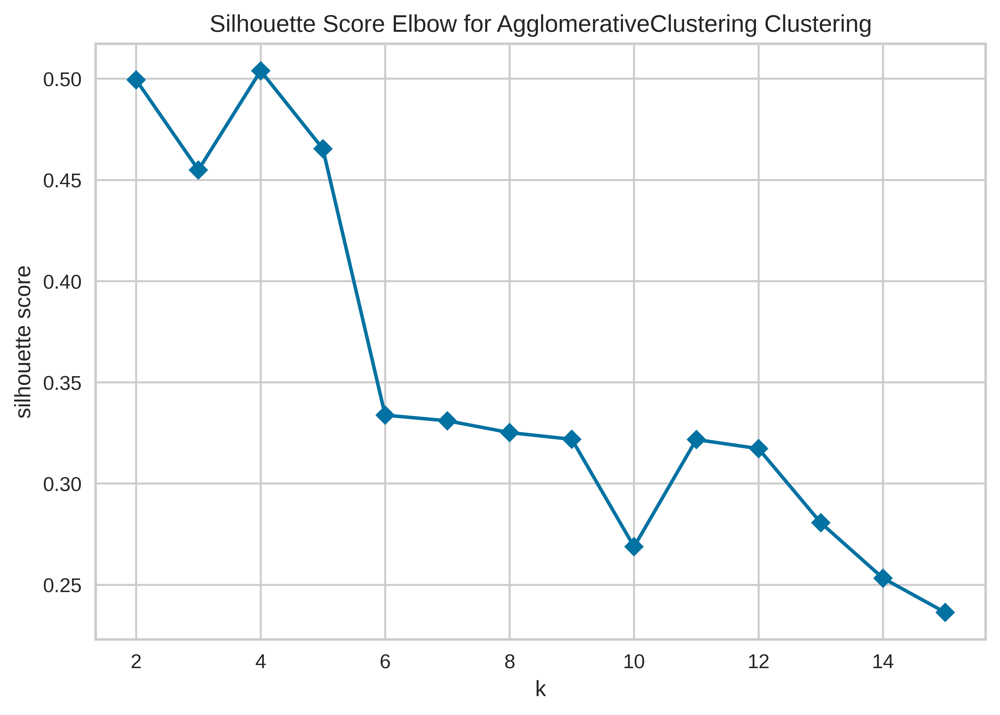

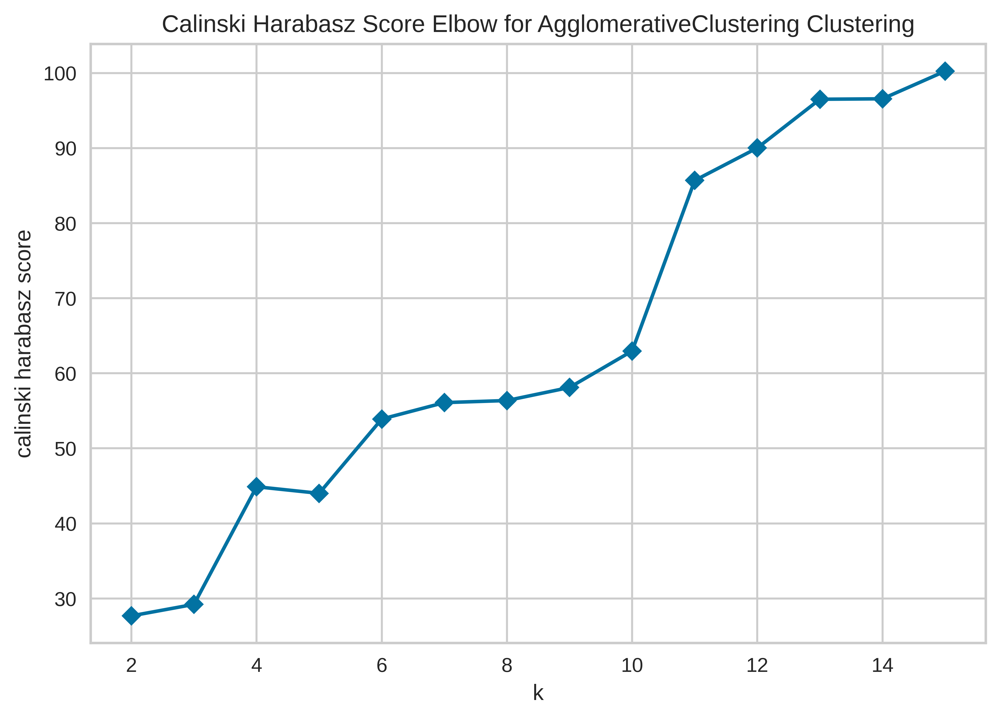

In [43]:
model = AgglomerativeClustering(affinity="euclidean", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_morph_embs_insp)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(shared_jump_morph_embs_insp)
ax = visualizer.show()


The optimal number of cluster seems to be 10 for our batch-centered JUMP morphological profiles.

In [44]:
model = AgglomerativeClustering(n_clusters=10, affinity="euclidean", linkage="complete")
shared_jump_morph_embs_insp_cluster_labels = model.fit_predict(
    shared_jump_morph_embs_insp
)
shared_jump_morph_embs_insp_clusters = pd.DataFrame(
    shared_jump_morph_embs_insp_cluster_labels,
    index=shared_jump_morph_embs_insp.index,
    columns=["cluster"],
)
shared_jump_morph_embs_insp_clusters.head()

,cluster
PRKACA,8
ATF4,0
DIABLO,0
BRAF,2
MYD88,0


---
## Rohban image embeddings



In [45]:
shared_rohban_img_embs = mean_rohban_img_embs.loc[shared_genes]

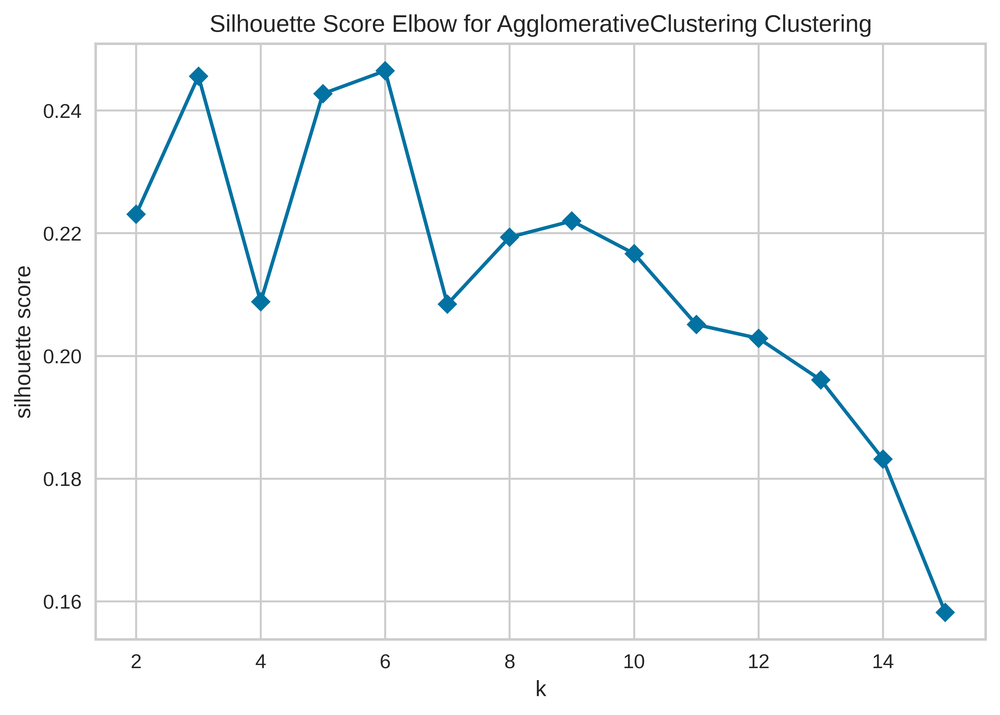

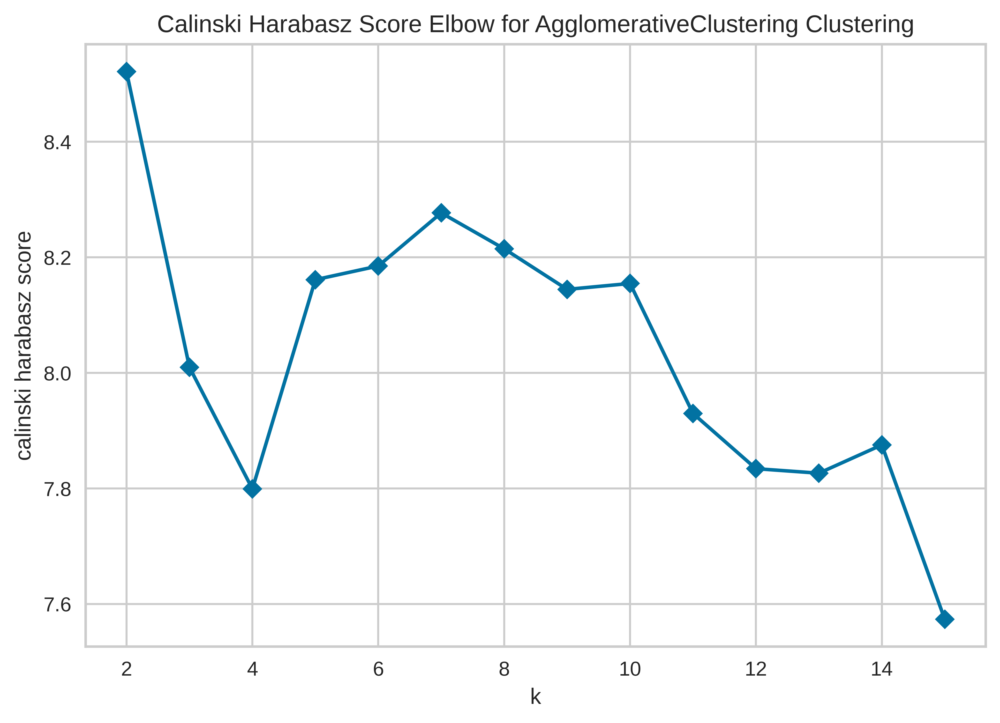

In [46]:
model = AgglomerativeClustering(affinity="euclidean", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(shared_rohban_img_embs)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(shared_rohban_img_embs)
ax = visualizer.show()


The optimal number of cluster seems to be 10 for our batch-centered JUMP morphological profiles.

In [47]:
model = AgglomerativeClustering(n_clusters=10, affinity="euclidean", linkage="complete")
shared_rohban_img_embs_cluster_labels = model.fit_predict(shared_rohban_img_embs)
shared_rohban_img_embs_clusters = pd.DataFrame(
    shared_rohban_img_embs_cluster_labels,
    index=shared_rohban_img_embs.index,
    columns=["cluster"],
)
shared_rohban_img_embs_clusters.head()

,cluster
labels,
PRKACA,3
ATF4,9
DIABLO,6
BRAF,1
MYD88,6


---
## Rohban morphological profiles



In [48]:
shared_rohban_morph_profiles = mean_rohban_morph_profiles.loc[shared_genes]

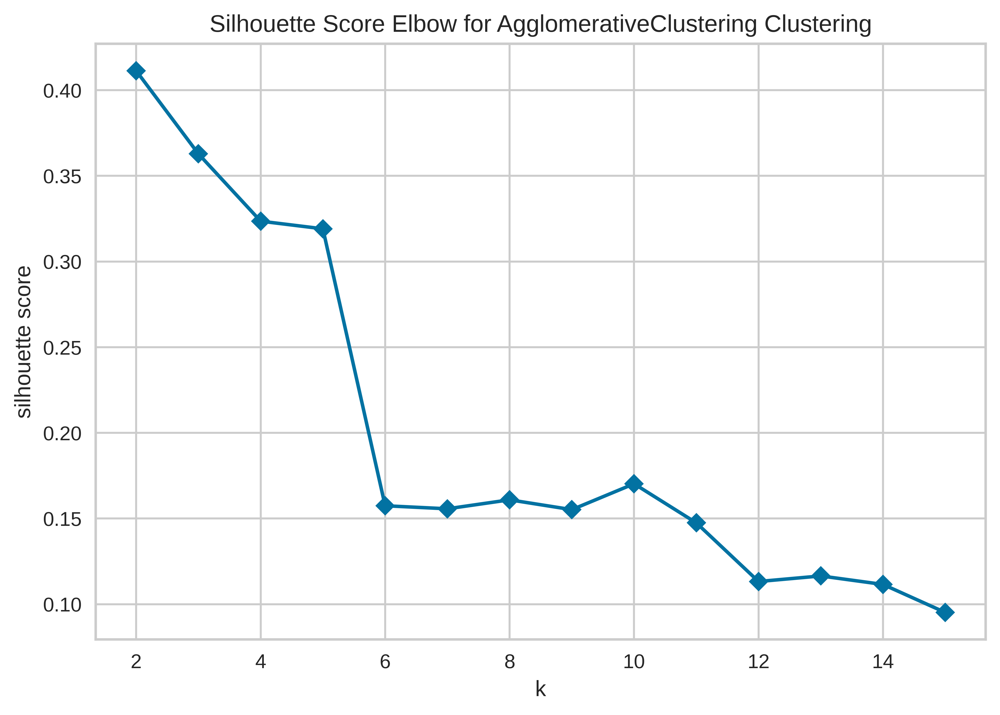

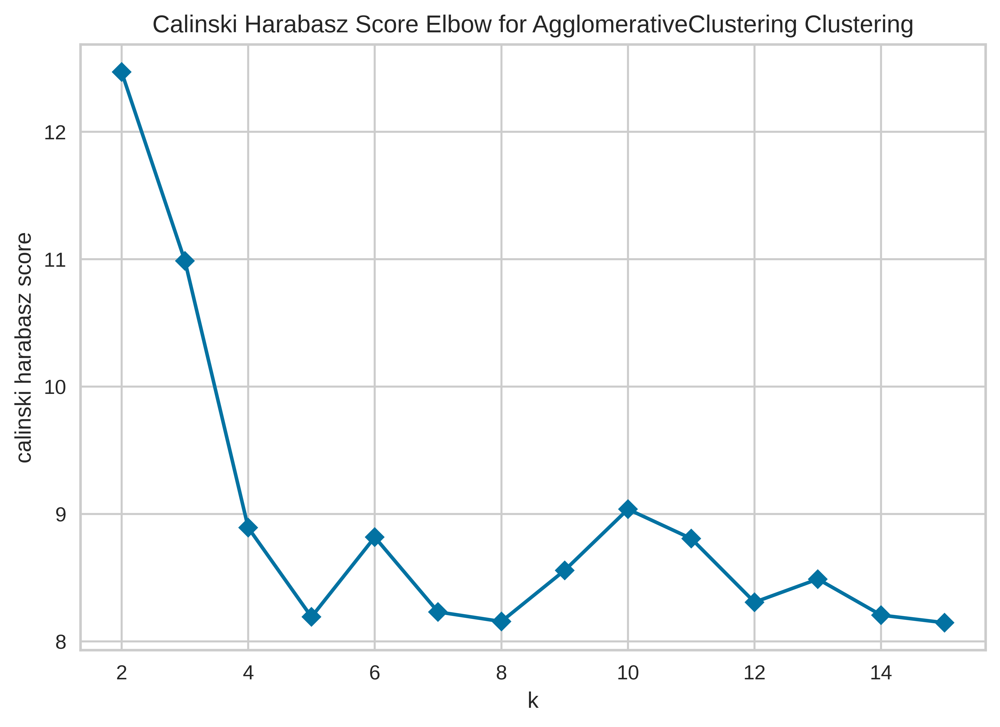

In [49]:
model = AgglomerativeClustering(affinity="euclidean", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(shared_rohban_morph_profiles)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(shared_rohban_morph_profiles)
ax = visualizer.show()


The optimal number of cluster seems to be 9 for our batch-centered JUMP morphological profiles.

In [50]:
model = AgglomerativeClustering(n_clusters=9, affinity="euclidean", linkage="complete")
shared_rohban_morph_embs_cluster_labels = model.fit_predict(
    shared_rohban_morph_profiles
)
shared_rohban_morph_embs_clusters = pd.DataFrame(
    shared_rohban_morph_embs_cluster_labels,
    index=shared_jump_morph_embs.index,
    columns=["cluster"],
)
shared_rohban_morph_embs_clusters.head()

,cluster
PRKACA,2
ATF4,0
DIABLO,0
BRAF,1
MYD88,5


---

## CMap signatures

In [51]:
shared_cmap_sigs = cmap_sigs.loc[shared_genes]

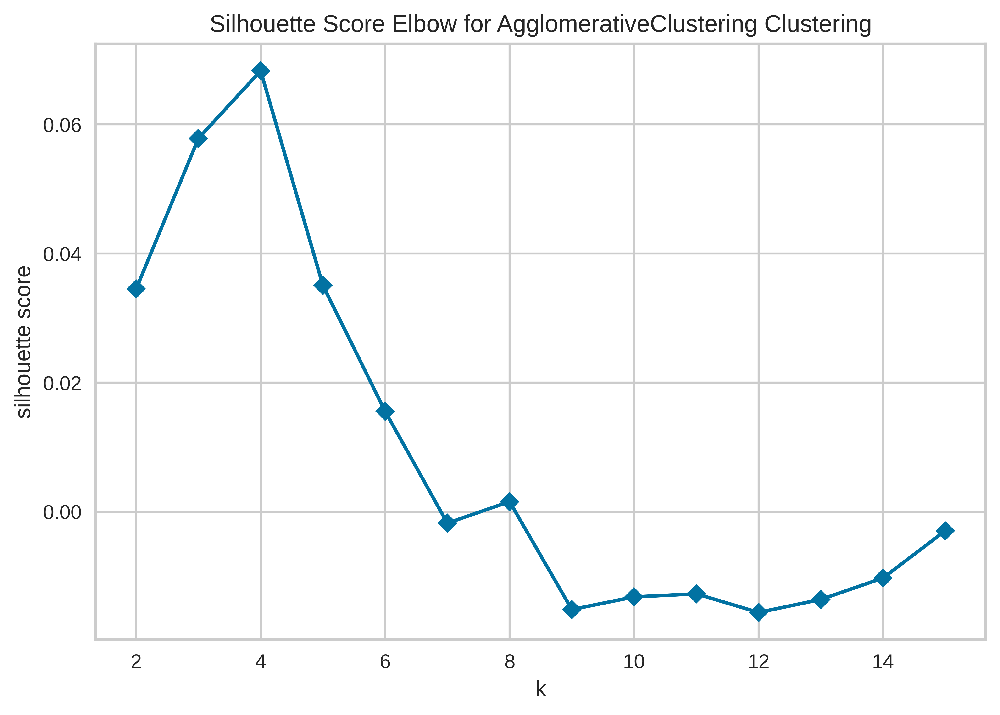

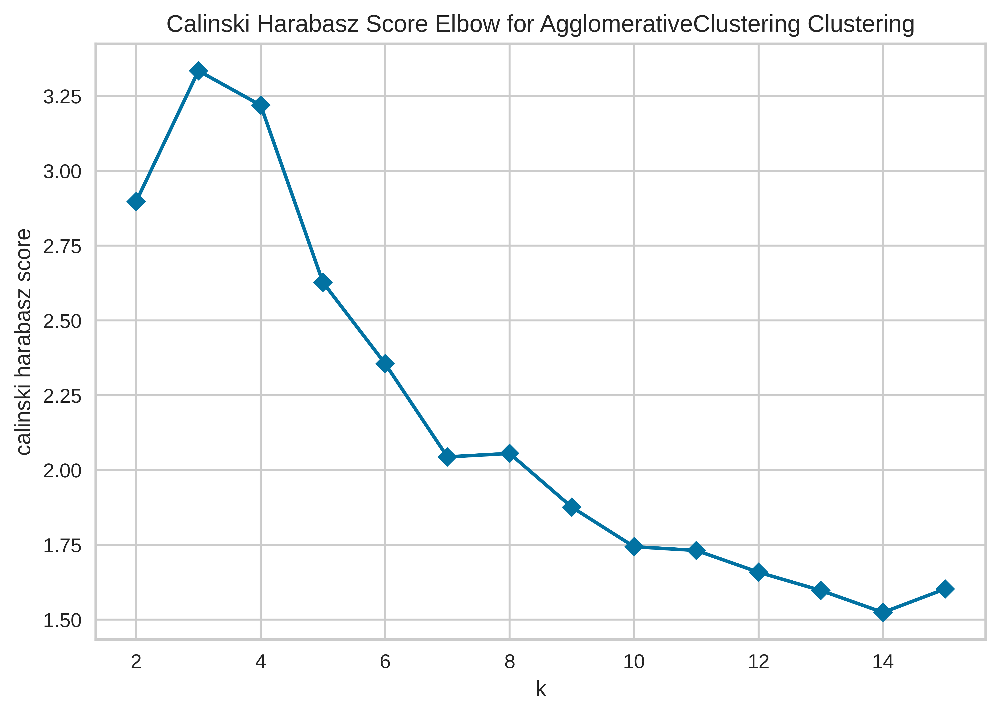

In [52]:
model = AgglomerativeClustering(affinity="cosine", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(shared_cmap_sigs)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(shared_cmap_sigs)
ax = visualizer.show()


The optimal number of cluster seems to be 8 for our batch-centered JUMP morphological profiles.

In [53]:
model = AgglomerativeClustering(n_clusters=8, affinity="cosine", linkage="complete")
shared_cmap_sigs_cluster_labels = model.fit_predict(shared_cmap_sigs)
shared_cmap_sigs_clusters = pd.DataFrame(
    shared_cmap_sigs_cluster_labels,
    index=shared_cmap_sigs.index,
    columns=["cluster"],
)
shared_cmap_sigs_clusters.head()

,cluster
labels,
PRKACA,3
ATF4,3
DIABLO,3
BRAF,5
MYD88,3


---

## Regulatory gene embeddings (using CMap information)

In [54]:
shared_reg_embs = reg_embs.loc[shared_genes]

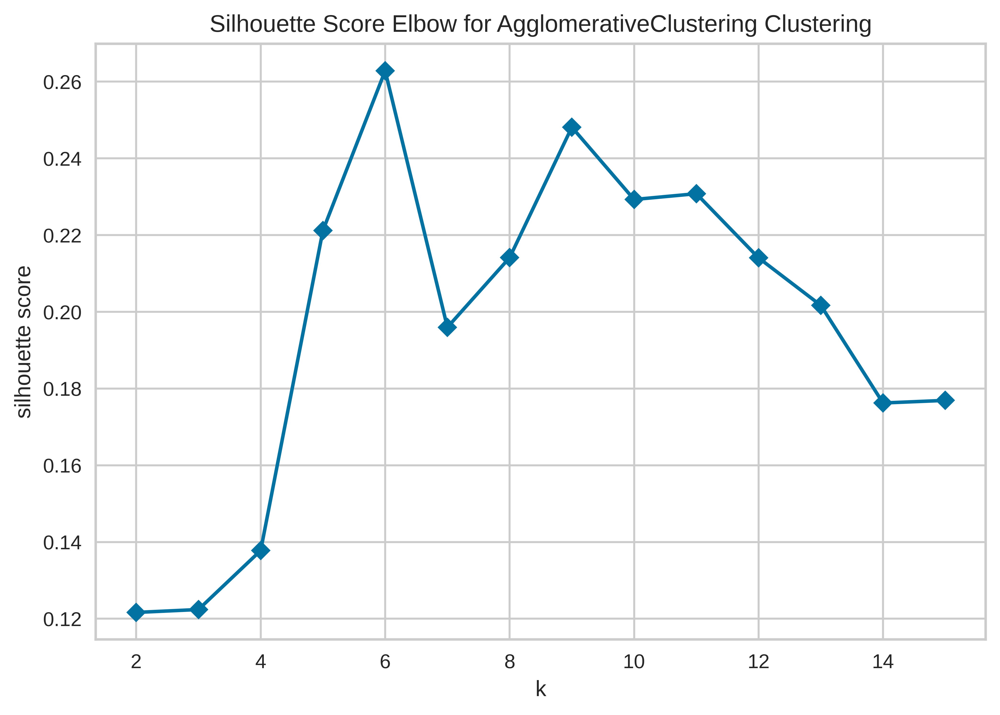

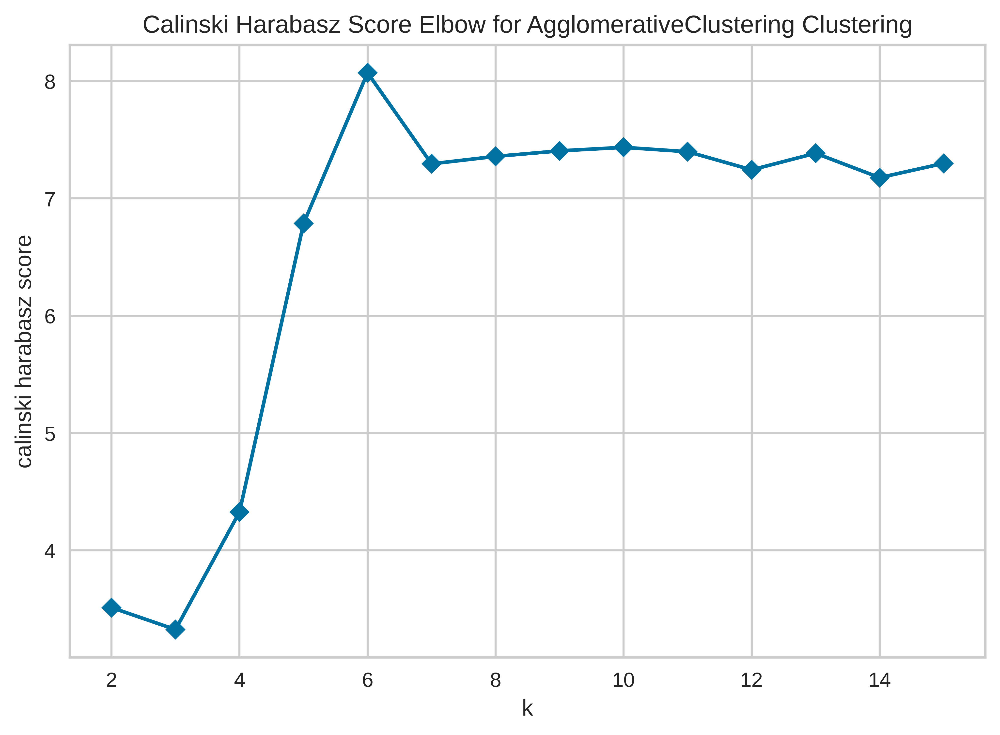

In [55]:
model = AgglomerativeClustering(affinity="cosine", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(shared_reg_embs)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(shared_reg_embs)
ax = visualizer.show()


The optimal number of cluster seems to be 6 for the regulatory embeddings.

In [56]:
model = AgglomerativeClustering(n_clusters=6, affinity="cosine", linkage="complete")
shared_reg_embs_cluster_labels = model.fit_predict(shared_reg_embs)
shared_reg_embs_clusters = pd.DataFrame(
    shared_reg_embs_cluster_labels,
    index=shared_reg_embs.index,
    columns=["cluster"],
)
shared_reg_embs_clusters.head()

,cluster
PRKACA,2
ATF4,4
DIABLO,1
BRAF,3
MYD88,0


---

# Co-clustering of the different profiles, signatures and embeddings

We will now assess the co-clustering of the different embeddings using their optimal cluster solutions computed in the previous section.

In [57]:
all_cluster_solutions = {
    "JUMP image embeddings": shared_jump_img_embs_clusters,
    "Batch-centered JUMP image embeddings": shared_jump_img_embs_bc_clusters,
    "INSP-corrected JUMP image embeddings": shared_jump_img_embs_insp_clusters,
    "JUMP morphological profiles": shared_jump_morph_embs_clusters,
    "Batch-centered JUMP morphological profiles": shared_jump_morph_embs_bc_clusters,
    "INSP-corrected JUMP morphological profiles": shared_jump_morph_embs_insp_clusters,
    "Rohban image embeddings": shared_rohban_img_embs_clusters,
    "Rohban morphological embeddings": shared_rohban_morph_embs_clusters,
    "CMap signatures": shared_cmap_sigs_clusters,
    "Regulatory embeddings (CMap informed)": shared_reg_embs_clusters,
}

In [58]:
pval_df = pd.DataFrame(index=list(all_cluster_solutions.keys()), columns=list(all_cluster_solutions.keys()))
assessed_coclusters = []
for k1, v1 in all_cluster_solutions.items():
    for k2, v2 in all_cluster_solutions.items():
        if k1 != k2 and (k1,k2) not in assessed_coclusters:
            v2 = v2.loc[v1.index]
            cc_results = run_cc_test(np.array(v1).flatten(), np.array(v2).flatten(), b=1000, score="mi", random_state=1234)
            pval_df.loc[k1,k2] = cc_results["pval"]
            pval_df.loc[k2,k1] = cc_results["pval"]
            assessed_coclusters.append((k1,k2))
        elif k1==k2:
            pval_df.loc[k1,k1] = 0


100%|██████████| 1000/1000 [00:00<00:00, 1713.91it/s]


<AxesSubplot:>

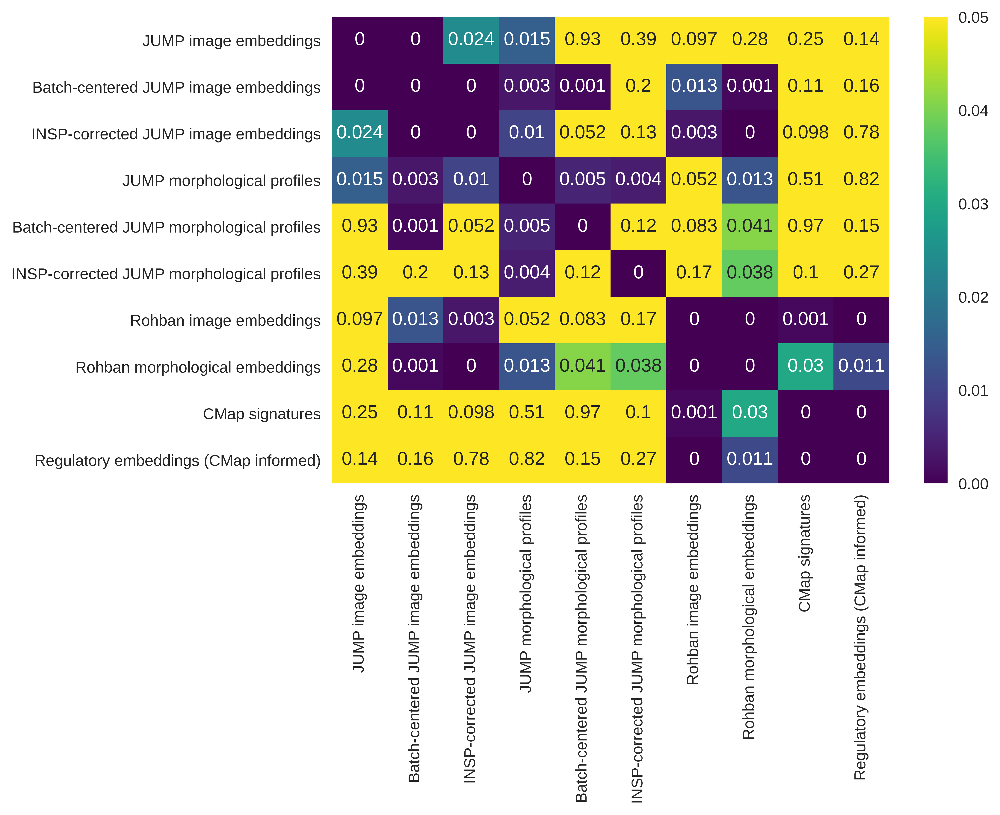

In [59]:
pval_df = pd.DataFrame(
    np.array(pval_df).astype(float), index=pval_df.index, columns=pval_df.columns
)
sns.heatmap(pval_df, annot=True, vmax=0.05, cmap="viridis")

The plot above shows one reason for the current challenges of predicting unseen overexpression conditions in the new data set. The different batch effect removal approaches seem to either not fully remove these confounding effects or no show much similarity of the with what we had observed in the study of Rohban et al. Interestingly, we find a significant agreement of the morphological profiles from the JUMP and the Rohban data set. However, this can be explained that we see a number of cases where OE conditions which we found to give rise to similar chromatin configurations upon overexpression in the Rohban data were assessed in exactly the same batches in the JUMP data set. Thus the co-clustering seems to be more likely caused by the batch effects.

---

# Co-clustering of the training and test conditions

The second factor contributing to the difficulty of our validation task is that we aim to predict 144 OE conditions out of sample given only 31 OE conditions for the training set. For this to work the 31 shared conditions need to span sufficiently much of both the space that describes the chromatin organization of cells in the different OE conditions as well as the regulatory gene embedding space. This is because, the methods will not predict outside of the span of the training data.

To check how many of the regulatory gene embeddings of the gene targeted for OE in the test condition fall within the space of those from the train conditions, we will cluster the whole regulatory gene embedding space and assess how often the gene targets of the train and test conditions co-cluster.

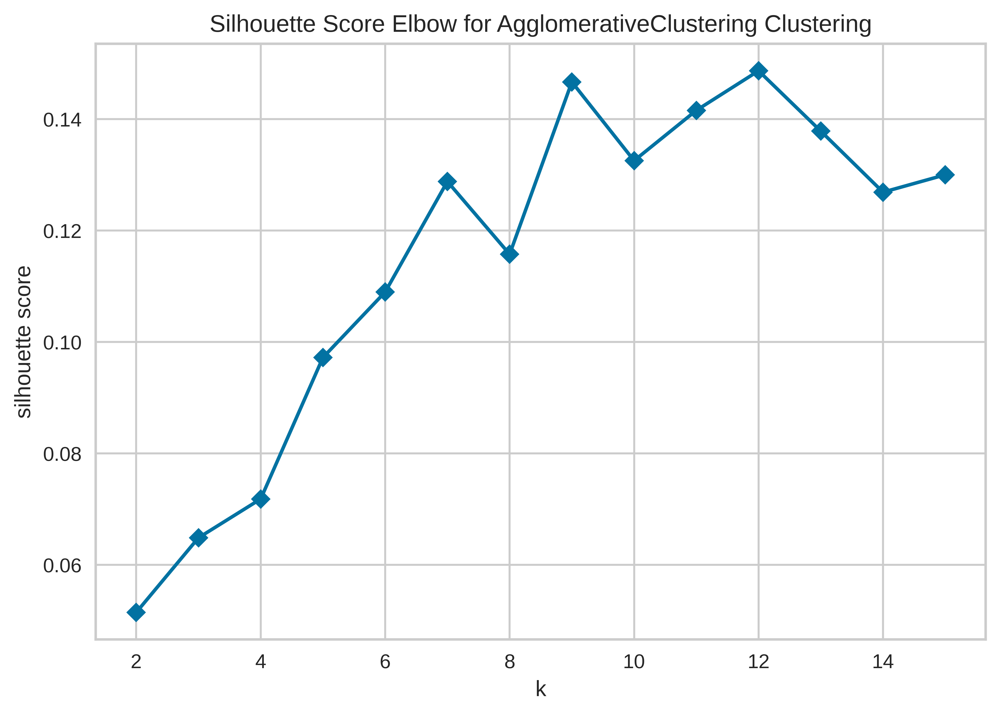

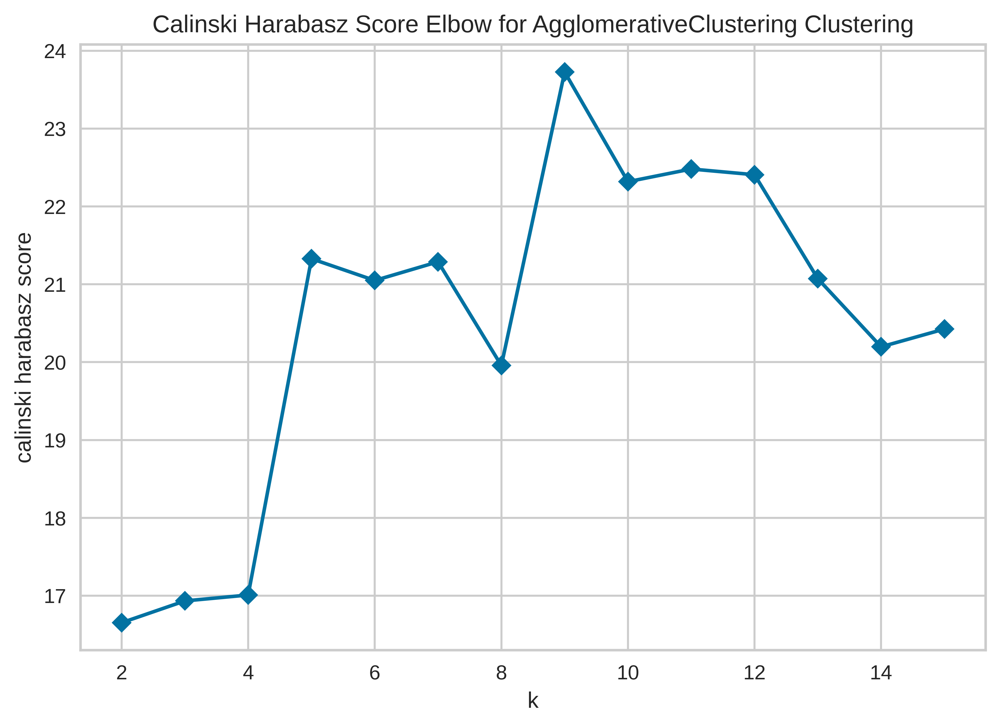

In [60]:
model = AgglomerativeClustering(affinity="cosine", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(reg_embs)
ax = visualizer.show()

visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(reg_embs)
ax = visualizer.show()


The optimal number of cluster seems to be 9 for our batch-centered JUMP morphological profiles.

In [61]:
model = AgglomerativeClustering(n_clusters=9, affinity="cosine", linkage="complete")
reg_embs_cluster_labels = model.fit_predict(reg_embs) + 1
reg_embs_clusters = pd.DataFrame(
    reg_embs_cluster_labels,
    index=reg_embs.index,
    columns=["cluster"],
)
reg_embs_clusters.head()

,cluster
PTN,6
KLK6,2
AURKB,1
TRAF2,7
TNNC1,1


Having identified the clusters, as discussed above we now assess how often the train and test conditions co-cluster.

In [62]:
train_genes = shared_genes
test_genes = list(set(mean_jump_img_embs.index) - set(train_genes) - {"EMPTY"})

In [63]:
cluster_occ = {"cluster": [], "geneset": [], "n_gs_genes": [], "n_genes": []}
for cluster in np.unique(reg_embs_clusters.cluster):
    cluster_genes = set(
        reg_embs_clusters.loc[reg_embs_clusters.cluster == cluster].index
    )
    for geneset in ["Training conditions", "Possible test conditions"]:
        if geneset == "Training conditions":
            gs_genes = set(train_genes)
        elif geneset == "Possible test conditions":
            gs_genes = set(test_genes)
        cluster_occ["cluster"].append(cluster)
        cluster_occ["n_gs_genes"].append(len(gs_genes.intersection(cluster_genes)))
        cluster_occ["n_genes"].append(len(cluster_genes))
        cluster_occ["geneset"].append(geneset)


cluster_occ = pd.DataFrame(cluster_occ)

(0.0, 35.0)

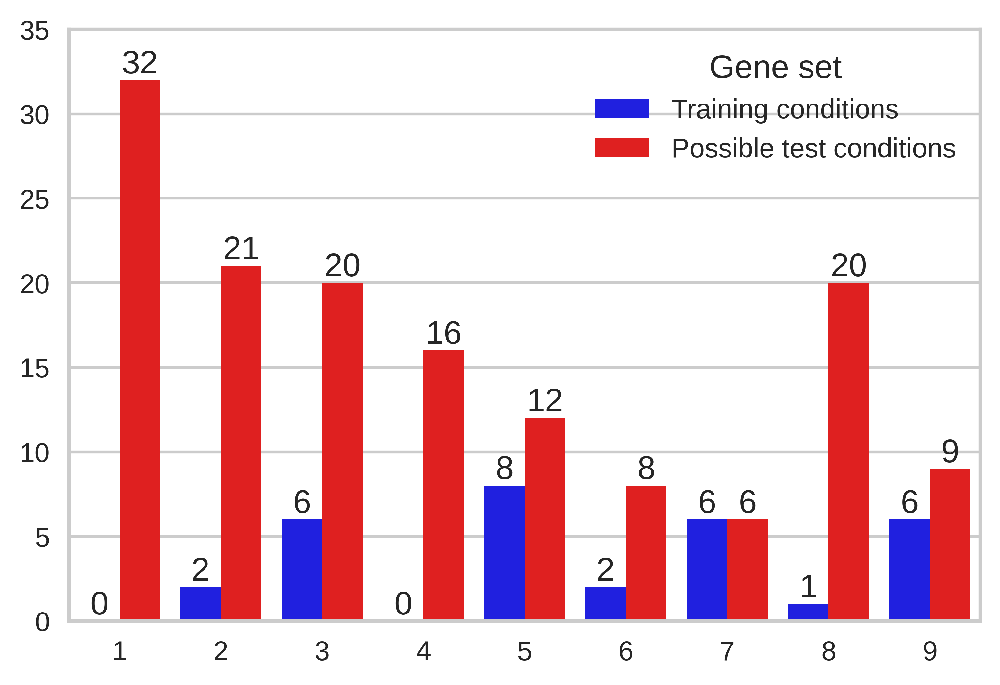

In [64]:
fig, ax = plt.subplots(figsize=[6, 4])
ax = sns.barplot(
    data=cluster_occ, x="cluster", y="n_gs_genes", hue="geneset", palette=["blue", "red"]
)
ax.set_xlabel("")
ax.set_ylabel("")
ax.legend(title="Gene set")
for i in ax.containers:
    ax.bar_label(
        i,
    )
ax.set_ylim([0, 35])

The above plot highlights the difficulty of our validation task, where you see to have only small number of training conditions compared to the test conditions. While for the clusters 4, 6 and 8 the imbalance between train and test samples is not that large, for the clusters 0, 1, 3, and 7 we observe a huge imbalance with for cluster 0 and 3 no training conditions being covered in the clusters. As a consequence it seems unlikely for any model to ever output a prediction close to any member of cluster 0 and 1. To get a better idea of the similarity of these cluster, we will plot a tSNE plot for the regulatory embeddings and highlight the clusters as well as the train and test genes.

In [65]:
reg_embs_clusters.loc[["YWHAQ", "RARA", "HSPA1B", "CDK14", "MAPK8", "LDOC1"]]

,cluster
YWHAQ,3
RARA,6
HSPA1B,5
CDK14,3
MAPK8,9
LDOC1,3


In [68]:
tmp = reg_embs.copy()
tmp = pd.DataFrame(normalize(tmp), index=tmp.index, columns=tmp.columns)
tmp.loc["MEAN_ALL"] = tmp.mean(axis=0)
tmp.loc["MEAN"] = tmp.loc[shared_genes].mean(axis=0)
mapper = TSNE(
    perplexity=int(np.sqrt(len(tmp))) + 1,
    random_state=1234,
    init="pca",
    learning_rate="auto",
    metric="euclidean",
    square_distances=True,
)
reg_embs_clusters.loc["MEAN"] = "MEAN"
reg_embs_clusters.loc["MEAN_ALL"] = "MEAN_ALL"
embs = mapper.fit_transform(tmp)
embs = pd.DataFrame(embs, index=tmp.index, columns=["tSNE 1", "tSNE 2"])
embs["cluster"] = np.array(reg_embs_clusters.loc[embs.index, "cluster"])
embs["geneset"] = "other"
embs.loc[train_genes, "geneset"] = "train"
embs.loc[test_genes, "geneset"] = "test"
embs.cluster = np.array(embs.cluster).astype(object)

/home/paysan_d/miniconda3/envs/i2r/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


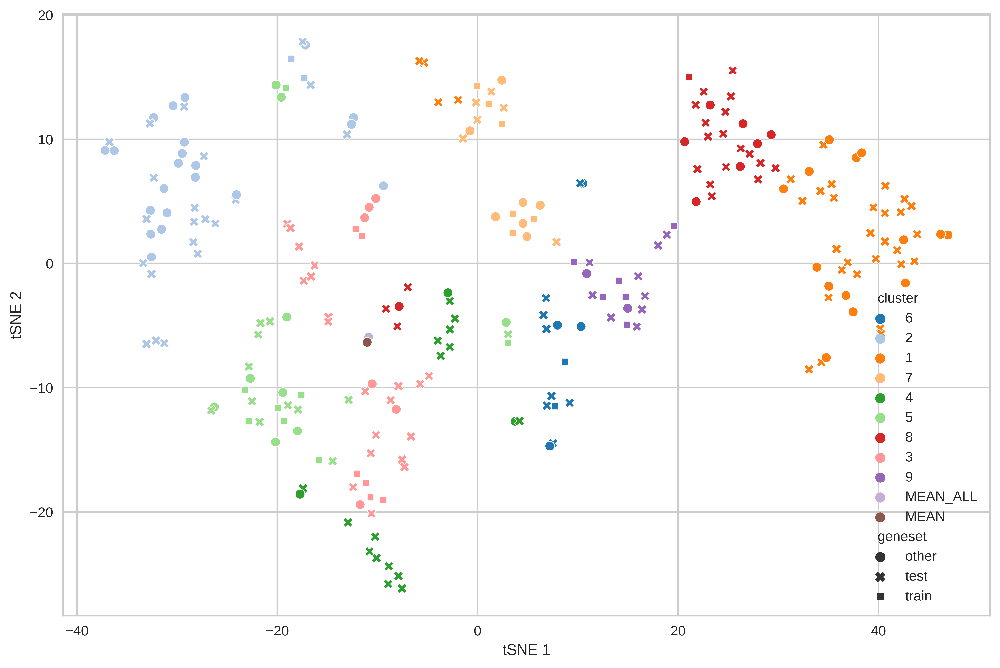

In [69]:
fig, ax = plt.subplots(figsize=[12, 8])
ax = sns.scatterplot(
    data=embs, x="tSNE 1", y="tSNE 2", hue="cluster", style="geneset", palette="tab20"
)

While the tSNE plot obviously not perfectly represents the data distribution, we still observe that in particular the test conditions with gene targets falling into cluster 0, 1 and 7 will be very hard to predict there no or only very few not well distributed training samples are available for these clusters. Unfortunately, these 3 clusters combine for roughly 50% of the overall test conditions.

---

# Data export

In [70]:
output_dir = "../../../data/experiments/jump/images/embedding/all_embeddings"
os.makedirs(output_dir, exist_ok=True)

mean_emb_output_dir = os.path.join(output_dir, "mean_embeddings")
os.makedirs(mean_emb_output_dir, exist_ok=True)

mean_batch_emb_output_dir = os.path.join(output_dir, "mean_batch_embeddings")
os.makedirs(mean_batch_emb_output_dir, exist_ok=True)

In [71]:
mean_jump_img_embs.to_csv(os.path.join(mean_emb_output_dir, "mean_jump_img_embs.csv"))
mean_jump_img_embs_bc.to_csv(
    os.path.join(mean_emb_output_dir, "mean_jump_img_embs_bc.csv")
)
mean_jump_img_embs_insp.to_csv(
    os.path.join(mean_emb_output_dir, "mean_jump_img_embs_insp.csv")
)

mean_batch_jump_img_embs.to_csv(
    os.path.join(mean_batch_emb_output_dir, "mean_batch_jump_img_embs.csv")
)
mean_batch_jump_img_embs_bc.to_csv(
    os.path.join(mean_batch_emb_output_dir, "mean_batch_jump_img_embs_bc.csv")
)
mean_batch_jump_img_embs_insp.to_csv(
    os.path.join(mean_batch_emb_output_dir, "mean_batch_jump_img_embs_insp.csv")
)

In [72]:
mean_jump_morph_profiles.to_csv(
    os.path.join(mean_emb_output_dir, "mean_jump_morph_profiles.csv")
)
mean_jump_morph_profiles_bc.to_csv(
    os.path.join(mean_emb_output_dir, "mean_jump_morph_profiles_bc.csv")
)
mean_jump_morph_profiles_insp.to_csv(
    os.path.join(mean_emb_output_dir, "mean_jump_morph_profiles_insp.csv")
)

mean_batch_jump_morph_profiles.to_csv(
    os.path.join(mean_batch_emb_output_dir, "mean_batch_jump_morph_profiles.csv")
)
mean_batch_jump_morph_profiles_bc.to_csv(
    os.path.join(mean_batch_emb_output_dir, "mean_batch_jump_morph_profiles_bc.csv")
)
mean_batch_jump_morph_profiles_insp.to_csv(
    os.path.join(mean_batch_emb_output_dir, "mean_batch_jump_morph_profiles_insp.csv")
)

In [73]:
mean_rohban_img_embs.to_csv(os.path.join(output_dir, "mean_rohban_img_embs.csv"))
cmap_sigs.to_csv(os.path.join(output_dir, "cmap_signatures.csv"))
reg_embs["cluster"] = np.array(reg_embs_clusters.loc[reg_embs.index])
reg_embs.to_csv(os.path.join(output_dir, "regulatory_gene_embeddings_using_cmap.csv"))
